In [1]:
from math import pi
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import geopandas as gpd
import folium
import datetime
import difflib
import branca
import math
from bokeh.models import ColumnDataSource, HoverTool, Label, Legend, LinearAxis, Range1d, FactorRange
from bokeh.plotting import figure, show, save
from bokeh.io import output_notebook, curdoc, output_file, reset_output
from bokeh.layouts import layout, row, column
from bokeh.models import CheckboxGroup, CustomJS
from bokeh.models.widgets import Tabs, Panel
from bokeh.palettes import brewer, Category20c
from bokeh.transform import cumsum
from folium.plugins import TimestampedGeoJson, HeatMap, HeatMapWithTime
from scipy import stats
from scipy.interpolate import griddata
from scipy.ndimage.filters import gaussian_filter
from sklearn.preprocessing import OneHotEncoder
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import train_test_split, RandomizedSearchCV, validation_curve
from sklearn.ensemble import RandomForestRegressor, ExtraTreesRegressor
from sklearn.linear_model import LinearRegression, SGDRegressor
from sklearn import metrics, tree

output_notebook()

Loading BokehJS ...

# Explainer Notebook - Biking in San Francisco
This is the Explainer Notebook for the **Biking in San Francisco - If you build it, will they come?** final project for 02806 - Social Data Analysis, 2022. This compliments the Website Blog Post that was part of the assignment.

### The website [can be found here](https://s164428.github.io/SanFranciscoBiking/posts/sanfranciscobiking/).

### Table of Contents
* [**1. Motivation**](#1.-Motivation)
    * [The Datasets](#The-Datasets)
    * [Why these Datasets?](#Why-these-Datasets?)
    * [What was the goal for the end-user Experience?](#What-was-the-goal-for-the-end-user-Experience?)
* [**2. Basic Statistics**](#2.-Basic-Statistics)
    * [Data Cleaning and Preprocessing](#Data-Cleaning-&-Preprocessing)
        * [Network Dataset](#Data-Cleaning-&-Preprocessing)
        * [Manual Counts Dataset](#Manual-Counts-Processing)
        * [Automatic Counts Dataset](#Counts-Processing-&-Repairing)
        * [Deriving Counter Lanes](#Counter-Lanes)
        * [Class Color Selections](#Class-Color-Selections)
    * [Exploring the Data](#Exploring-the-Data)
        * [Comparing Network Growth to Volume Growth](#Exploring-the-Data)
        * [Exploring the Bike Network Dataset](#Exploring-the-Bike-Network-Dataset)
        * [Exploring the Counts Dataset](#Exploring-the-Counts-Dataset)
* [**3. Data Analysis**](#3.-Data-Analysis)
    * [Network & Bicycle Growth over the Years](#3.-Data-Analysis)
    * [Bike Lane Class Correlations](#Bike-Lane-Class-Correlations)
        * [Bike Lane Class Before-and-After](#Bike-Lane-Class-Before-and-After)
    * [Machine Learning](#Machine-Learning)
        * [Choosing a Model](#Choosing-a-Model)
        * [Feature Importances](#Feature-Importances)
* [**4. Genre**](#4.-Genre)
    * [Visual Narrative Tools Used](#Visual-Narrative-Tools-Used)
    * [Narrative Structure Tools Used](#Narrative-Structure-Tools-Used)
* [**5. Visualizations**](#5.-Visualizations)
    * [Section 1: Introductory Data Presentation](#Section-1:-Introductory-Data-Presentation)
        * [A) An overall map of the Data](#A\)-An-overall-map-of-all-the-Data)
        * [B) Bicycle Patterns in San Francisco (Temporal Patterns)](#B\)-Bicycle-Patterns-in-San-Francisco-(Temporal-Patterns))
        * [C) Bicycle Patterns in San Francisco (Geographic Patterns)](#C\)-Bicycle-Patterns-in-San-Francisco-(Geographic-Patterns))
            * [C-2) The map of District Volumes](#C-2\)-The-map-of-the-District-Volumes)
        * [D) Heatmap of Bike Counts over Time](#D\)-Heatmap-of-Bike-Counts-over-Time)
    * [Section 2: Growth Visualizations](#Section-2:-Growth-Visualizations)
        * [A) Bike Network vs. Bike Count Growth](#A\)-Bike-Network-vs.-Bike-Count-Growth)
        * [B) Animated Bike Network Evolution Map](#B\)-Animated-Bike-Network-Evolution-Map)
        * [C) Visualization of Lane Class Distributions](#C\)-Visualization-of-Lane-Class-Distributions)
        * [D) Bike Lane Class Construction Effects](#D\)-Bike-Lane-Class-Construction-Effects)
    * [Section 3: Machine Learning](#Section-3:-Machine-Learning)
        * [A) Model Performance](#A\)-Model-Performance)
        * [B) Feature Importance](#B\)-Feature-Importance)
        * [C) Heatmap Prediction Comparison](#C\)-Heatmap-Prediction-Comparison)
        * [D) The Big Final Visualization: Predicting across all of San Francisco](#D\)-The-Big-Final-Visualization:-Predicting-across-all-of-San-Francisco)
    [Why were these visualizations chosen?](#Why-were-these-visualizations-chosen?)
* [**6. Discussion**](#6.-Discussion)
    * [What went well?](#What-went-well?)
    * [What is still missing? What could be improved?](#What-is-still-missing?-What-could-be-improved?)
* [**Contributions**](#Contributions)

## 1. Motivation
The idea behind this project was to try and determine whether a city or governing body could do something that would tangibly invoke an increase in bike ridership, in order to reduce emissions and help work towards the much-needed better environment. If it was possible to show that bike riders *will* come if you just do this particular thing, then it could suggest some level of safety in taking the plunge and investing in said thing. This broader scope was then narrowed down to whether *bike lanes* invoked this change or not.

### The Datasets

For the purposes of this project, we narrowed our investigation down to bike data in San Francisco. We took hold of the following datasets:
* [**San Francisco Bike Network**](https://data.sfgov.org/Transportation/MTA-bikewaynetwork/ygmz-vaxd): Bike lanes, construction dates, lane types, and more...
* [**San Francisco Manual Bike Counts**](https://data.sfgov.org/Transportation/Bike-Volume-Manual-Counts/v4v2-5x7s): Manual counts conducted 2006-2017...
* [**San Francisco Automatic Bike Counts (Hourly)**](https://www.sfmta.com/reports/hourly-bike-counts-dashboard): Automatic hourly counts conducted by automatic counters in the lanes 2016-Present...
* [**San Francisco Bicycle Loop Counters**](https://data.sfgov.org/Transportation/Bicycle-Loop-Counters/7j2t-hunp): Geo-Spatial and property information about the automatic counters in San Francisco...
* [**San Francisco Police Districts**](https://data.sfgov.org/Public-Safety/Current-Police-Districts/wkhw-cjsf): Geo-Spatial data about the districts in San Francisco...
* [**Bike Lanes Installed or Updateds Table**](https://www.sfmta.com/reports/miles-bike-lanes-installed): Table including some of the updates and install dates of some streets...

Additionally, several informational resources (that were not datasets) were used. These include [explanations about Bike Lane Classes](https://www.sfmta.com/getting-around/bike/bike-improvements-toolkit) and [estimated costs per mile of Bike Lane Classes](https://www.nvta.ca.gov/sites/default/files/Appendix%20G_Facility%20Cost%20Estimate%20Assumptions_FINAL.pdf).

### Why these Datasets?

It was especially important to find data about the bike lane network in a city, where the date of construction was included in the data. On top of this, it was also crucial that the bike count data would predate some or most of these bike lane construction dates. Some cities provided one, while others provided the second. San Francisco was one of the only ones we could find where both of these were available at the same time.

Together, these datasets form the complete picture of bike ridership in San Francisco. The Bike Network dataset also includes even more information to work with, such as the type of lane, its length in miles, directions, safety, and much more.

### What was the goal for the end-user Experience?

The blog post was centered around the famously-known "What came first: The Chicken or the Egg?"-question, but then directed towards *Bike Lanes* and *Bicyclists* respectively. The idea was to entice some genuine curiousity by posing a genuinely interesting question, and present this in a very lighthearted and easy-to-read manner that anyone could follow. The question would draw in the reader's interest, and then the question would be explored through the use of the data. By formulating the narrative in such a way that it felt like the analysis was concurrently happening *while* the reader read, it would make the reader feel more a part of this investigation, and thus more engaged.

All plots made along the way were meant to be interactive, have many bright colors, and overall look engaging to the reader. It was meant that the reader could read the narrative text, then stop to play around with each plot at their own pace, before continuing on reading down below.

## 2. Basic Statistics
The general statistics of the datasets are written below.

| Dataset | Rows | Columns | Each row is a | File Size |
| --- | --- | --- | --- | --- |
| **San Francisco Bike Network** | 5,381 | 31 | Lane Segment | 3.6MB |
| **San Francisco Manual Bike Counts** | 119 | 20 | Count Location | 56KB |
| **San Francisco Automatic Bike Counts (Hourly)** | 959,400 | 6 | Count | 60.2MB |
| **San Francisco Bicycle Loop Counters** | 75 | 12 | Automatic Counter | 25KB |
| **San Francisco Police Districts** | 10 | 6 | District | 302KB |
| **Bike Lanes Installed or Updateds Table** | 2859 | 6 | Lane Segment Update | 153KB |

### The datasets are loaded below

In [2]:
#### Dataset 1: The Bike Network
# This has some missing values which we will attempt to repair later
# The necessary field that should be floats are converted as such (otherwise this is all strings)
network = gpd.read_file("Data/SanFrancisco/MTA.bikewaynetwork.geojson")
network["length"] = network["length"].astype(float)
network["install_yr"] = network["install_yr"].astype(float)
network["update_yr"] = network["update_yr"].astype(float)

In [3]:
#### Dataset 2: The Manual Bike Counts
# This dataset had rows for each location, and columns for each year of counting.
manual_counts = gpd.read_file("Data/SanFrancisco/Bike Volume - Manual Counts.geojson")
manual_counts = manual_counts[["objectid", "globalid", "location", "cnn", "loc_id", "yr2006_pm", "yr2007_pm", "yr2008_pm", "yr2009_pm", "yr2010_pm", "yr2011_pm", "yr2011padj", "yr2013_pm", "yr2014_pm", "yr2015_pm", "yr2016_pm", "yr2017_pm", "nodelayer", "geometry"]]

In [4]:
#### Dataset 3: The Automatic Bike Counts
# This dataset only contains the counts-per-hour across "Weekdays" and "Weekends" for each month - there are no exact dates
# The data on SF's data portal was private. Instead, this is generated on the SFMTA's website based on the data from SF's Open Data
# This explains the limitations. Additionally, since it was generated, it was localized to Danish. We correct that here.
counts = pd.read_csv("Data/SanFrancisco/HOURLYTABLE.csv", decimal=",", thousands=".")
counts.columns = "Location", "Hour", "Month", "DayType", "Year", "Count" # <-- Rename the columns for simplicity
counts.Month = counts.Month.map({
    "januar": "January",
    "februar": "February",
    "marts": "March",
    "april": "April",
    "maj": "May",
    "juni": "June",
    "juli": "July",
    "august": "August",
    "september": "September",
    "oktober": "October",
    "november": "November",
    "december": "December",
})

# Additionally, we create an ordered Month list so we can re-use it later to sort instead of typing it all out
months = ["January", "February", "March", "April", "May", "June", "July", "August", "September", "October", "November", "December"]

In [5]:
#### Dataset 4: The Automatic Bike Counters (Bike Loop Counters)
# This dataset contains the information about each automatic bike counter, including its location.
# We want to parse its install date as a proper date.
counters = gpd.read_file("Data/SanFrancisco/Bicycle Loop Counters.geojson")
counters["install_date"] = pd.to_datetime(counters["install_date"])

In [6]:
#### Dataset 5: Police Districts
# This dataset is actually the same as we've worked with before.
districts = gpd.read_file("Data/SanFrancisco/Current Police Districts.geojson")
districts["shape_area"] = districts["shape_area"].astype(float)

In [7]:
#### Dataset 6 is used only during the processing of Dataset 1, and will be loaded then.

## Data Cleaning & Preprocessing

* Initially, the most important thing was to try and fill out some of the missing data in the ***Bike Network*** dataset, where the install or update year was not specified. The **Bike Lanes Installed or Updateds Table** was used for this purpose. Iterating through every lane segment and cross-referencing *street name* and *to- and from-streets* were used to fill in the blanks where they were found. Ultimately, while the lane repair dataset contained over 2000 rows, it was mostly a reflection of the existing bike network dataset, and almost all that were originally missing from there, were also missing here.

* **Additionally, _manual_ repairs through the use of a [historical map](https://www.sfmta.com/sites/default/files/reports-and-documents/2021/11/bike_network_2013_-_2021_1.pdf) was also attempted,** through the use of a Folium map and the link there. However it too did not find any that were not already filled in.

In [8]:
# Use the SFMTA's "Installed or Updated Bike Lanes" to fill in potential missing values
repairs = pd.read_csv("Data/SanFrancisco/BikeLanesInstalledorUpdatedsTable.csv")
repairs = repairs[~repairs.Street.isnull()]

# Set index to the streetname to make it quicker to look up! Uppercase is what's used by the network, so we apply that.
repairs.Street = repairs.Street.str.upper()
repairs.Street = repairs.Street.str.lstrip("0")
repairs["From St"] = repairs["From St"].str.upper()

# Preprocess the names: We want all upper-case, all "Street" and "St" to conjoin, all spaces removed, and all
# full stops for acronyms removed.
network_names = {}
for n1,n2 in [("Street", "streetname"), ("From St", "from_st"), ("To St", "to_st")]:
    l = lambda x: x.str.upper().str.lstrip("0").replace({
        "STREET": "ST",
        "CIRCLE": "CIR",
    }, regex=True).str.replace("[\s\.]", "", regex=True)
    repairs[n1] = l(repairs[n1])
    network_names[n1] = l(network[n2])
    
repairs = repairs.set_index("Street")

# Perform the repair!
# Go through each row in the original network where these values are non-existent, then look them up in this repair table
# At every lane, if we cannot find the street name in the repairs table directly, we will go through each of
# the other formats listed below:
#name_formats = [lambda r: r.streetname, lambda r: r.streetname.lstrip("0")]

# Now perform the repair!
num_repairs = 0
for i,lane in network.iterrows():
    blank_install = not lane.install_yr > 0
    blank_update = not lane.update_yr > 0
    
    # If this lane has missing values (and a streetname to look up with)
    if (blank_install or blank_update) and lane.streetname is not None:
        name = network_names["Street"].iloc[i]
        from_name = network_names["From St"].iloc[i]
        to_name = network_names["To St"].iloc[i]

        # If we find this name in the repairs table, we can apply its values
        if name in repairs.index:
            repair = repairs.loc[name]

            # If there's more than 1, find the one(s) which have the same To- and From-Streets
            if isinstance(repair, pd.DataFrame):
                repair = repair[(repair["From St"] == from_name) & (repair["To St"] == to_name)]

            # If we found any valid repairs, do this!
            if len(repair) > 0:

                # If there's more than 1, just pick the first one (it's the same street)
                if isinstance(repair, pd.DataFrame):
                    repair = repair.iloc[0]

                # Apply the install year if it is possible
                if blank_install and repair["Install Yr"] is not None and repair["Install Yr"] > 0:
                    lane.install_yr = repair["Install Yr"]
                    print("Repaired Install Year -->", lane.streetname, lane.install_yr)
                    num_repairs += 1

                # Apply the update year if it is possible
                if blank_update and repair.loc["Update Yr"] is not None and repair["Update Yr"] > 0:
                    lane.update_yr = repair["Update Yr"]
                    print("Repaired Update Year -->", lane.streetname, lane.update_yr)
                    num_repairs += 1

print(f'Successfully repaired {num_repairs} segment values!')

Repaired Update Year --> FOLSOM ST 2016.0
Successfully repaired 1 segment values!


### Manual Counts Processing
* The **Manual Counts** table contained rows for each location, and columns for each year, as well as some additional columns about the counting location. We wanted to rename these yearly-count indices to integers, such that we would be able to use math to index them more effectively. Additionally, the year *2012* was not counted by the SFMTA. Instead of having to work around this in every plot, we decided to add 2012 into it as the interpolated value between 2011 and 2013.

* **Later,** we would find that we needed to identify whether the dates of each counter existed both before and after its respective lane was *constructed*, as well as before and after it was *updated*. To accomplish this goal, the **Manual Counts** dataset was augmented with a *"first_year"* and *"last_year"* column which contained the range of years in which this counter contained non-NaN values.

The `yearlist` variable would also be used later.

In [9]:
# Rename the column indices into integers
manual_counts.columns = ["objectid", "globalid", "location", "cnn", "loc_id", 2006, 2007, 2008, 2009, 2010, 2011, "2011_Adj", 2013, 2014, 2015, 2016, 2017, "nodelayer", "geometry"]

# Turn into floats, and replace the -1 uncounted value with NaN
manual_counts[[2006,2007,2008,2009,2010,2011,"2011_Adj",2013,2014,2015,2016,2017]] = manual_counts[[2006,2007,2008,2009,2010,2011,"2011_Adj",2013,2014,2015,2016,2017]].astype(float)
manual_counts = manual_counts.replace(-1, np.nan)

# Insert an interpolation for the year 2012, just so it's easier to work with for visualizations
manual_counts.insert(12, 2012, (manual_counts[2011] + manual_counts[2013])/2)

# Annotate first and last valid year to each row
yearlist = [2006,2007,2008,2009,2010,2011,2012,2013,2014,2015,2016,2017]
manual_counts["first_year"] = [r.first_valid_index() for _,r in manual_counts[yearlist].iterrows()]
manual_counts["last_year"] = [r.last_valid_index() for _,r in manual_counts[yearlist].iterrows()]

### Counts Processing & Repairing

* A lot of counts in the **Automatic Counts** table had names that meant the same, but was just spelled *slightly* differently from those found in the **Automatic Counters** list, which would make them not match. This was later discovered due to the large abundance of counts that were unused during later analysis. To repair this, *string difference searching* was used across the counter names and locations in the counts table, after which the counts table was replaced with the found matchings, so that it now fully matched the **Automatic Counters** list where possible.

In [10]:
for location in counts[~counts.Location.isin(counters.location)].Location.unique():
    print(location)
    print("Closest Matches:", difflib.get_close_matches(location, counters.location, 3, 0.2), "\n")

14th St West of Valencia EB
Closest Matches: ['14th St East of Valencia EB', 'Market St West of Van Ness EB', 'North Point West of Polk St EB'] 

23rd Ave North of Clement SB
Closest Matches: ['23rd Ave. North of Clement SB', '23rd Ave. North of Clement NB', '2nd St North of Townsend SB'] 

23rd Avenue north of Clement NB
Closest Matches: ['23rd Ave. North of Clement NB', '23rd Ave. North of Clement SB', 'Arguello north of California NB'] 

(01) 11th St. Between Howard & Folsom
Closest Matches: ['11th St North of Folsom', '8th St. South of Folsom St.', 'Oak Street between Scott and Divisadero EB'] 

(02) 17th St. between Mission & Valencia
Closest Matches: ['14th St East of Valencia EB', 'Oak Street between Scott and Divisadero EB', 'Illinois St between Cesar Chavez SB'] 

(03) 20th Ave. On Lincoln at GG Park entrance
Closest Matches: ['7th Ave north of Kirkham SB', '6th Ave north of Kirkham SB', '7th Ave south of Kirkham NB'] 

(04) 2nd St. Between Brannan and Townsend - SB
Closest Ma

In [11]:
# By going through the list above one-by-one, we could identify 
# when certain lanes had slightly-mismatching names. Sometimes, if the
# description of a name was "Between X and Y" and there was another vague description,
# Google Maps was used to confirm whether these two relative descriptions would likely be the same

# Example --> "11th St. Between Howard & Folsom" - "11th St. North of Folsom"
# Howard is North of Folsom, placing this description at the same general location


counts["LocationMapped"] = counts.Location.replace({
    '23rd Ave North of Clement SB': '23rd Ave. North of Clement SB', # A dot was missing
    '23rd Avenue north of Clement NB': '23rd Ave. North of Clement NB', # Same as above
    '(01) 11th St. Between Howard & Folsom': '11th St North of Folsom', # Has a different name, but google maps shows Howard is also North, so they must match
    '(04) 2nd St. Between Brannan and Townsend - SB': '2nd St North of Townsend SB', # Used google maps to very that Brannan is indeed north
    '(05) 2nd St. Between Brannan and Townsend - NB': '2nd Street North of Townsend NB',
    '(07) 7th Ave. Between Lawton & Kirkham - NB': '7th Ave south of Kirkham NB', # Similar to above
    '(07) 7th Ave. Between Lawton & Kirkham - SB': '7th Ave north of Kirkham SB', # And again
    '(08) 7th St. NB between Brannan & Townsend': '7th St North of Townsend St NB', # Another google maps to the rescue!
    '(10) 8th St. Between Folsom & Harrison': '8th St. South of Folsom St.', # The name consistency is through the roof
    '(13) Cesar Chavez EB between Harrison & Folsom': 'Cesar Chavez West of Harrison EB', # Yup
    '(14) Duboce Bike Path behind Safeway': 'Duboce Bike Path East of Church', # This is the same
    '(15) Embarcadero NB between Bay & Sansome': 'Embarcadero South of Bay Street NB',
    '(16) Embarcadero SB between North Point & Bay': 'Embarcadero South of North Point SB',
    '(18) Fell St. Between Scott & Divisadero': 'Fell Street west of Scott WB',
    '(19) Folsom St. Between 8th & 9th': 'Folsom between 8th and 9th Sts. EB', # This one has a slight name change, and East-Bound added
    '(19) Folsom St. Between 8th & 9th ': 'Folsom between 8th and 9th Sts. EB', # A space added at the end weirdly
    '(20) Howard St. Between 8th & 9th': 'Howard West of 8th St. WB',
    '(21) Indiana St. Between 20th & 22nd - NB': 'Indiana St North of 22nd St NB', # The number is removed here
    '(21) Indiana St. Between 20th & 22nd - SB': 'Indiana St North of 22nd St SB', # This is South-Bound
    '(22) Market St. Totem EB between 9th & 10th': 'Market St Totem S EB',
    '(23) Market St. Totem WB between 9th & 10th': 'Market St. Totem N WB',
    '(24) Marina Bike Path East of Baker St.': 'Marina Bike Path East of Baker St', # Exact match! ... exceeeept that number, ouch
    '(28) North Point St. WB Between Larkin & Polk': 'North Point East of Polk St WB',
    '(29) Oak St. Between Scott & Dicisadero EB & (29) Oak St. Between Scott & Divisadero EB': 'Oak Street between Scott and Divisadero EB', # WHAT even is this
    '(30) Page East of Divisadero WB & (30) Page St. Between Webster & Buchanan - WB': 'Page East of Divisadero WB', # ??? (Well, it fits)
    '(30) Page East of Divisadero EB & (30) Page St. Between Webster & Buchanan - EB': 'Page East of Divisadero EB',
    '(31) Panhandle Bike Path Between Masonic & Ashbury': 'Panhandle Bike Path West of Masonic', # They like their numbers, huh?
    '(32) Polk St. Between Sutter & Post': 'Polk St South of Sutter St', # Aaaah, back to normal...
    '(33) Potrero St. SB Between 20th & 21st': 'Potrero north of 21st SB',
    '(36) Townsend St. Between 4th & 5th': 'Townsend East of 5th',
    '(38) Valencia St. SB Between Duboce & 14th': 'Valencia north of 14th SB',
    '(39) Valencia St. Totem NB Between 16th & 17th': 'Valencia St. Totem NB', # This one they just gave up on the relative positions
    'Arguello north of California NB ': 'Arguello north of California NB', # Space at the end always gets me
    'Broadway Tunnel west of Hyde St Overpass EB': 'Broadway Tunnel west of Hyde St Overpass',
    'Folsom between 8th and 9th Sts. EB (Out of Service': 'Folsom between 8th and 9th Sts. EB', # We don't care if it's out of service if it had counts
    'Harrison St. North of 22nd St. (out of service)': 'Harrison St. North of 22nd St.',
    'Market St East of 2nd St EB': 'Market St. East of 2nd St. EB', # St. was concatenated with a dot here
    'Market St Totem N WB': 'Market St. Totem N WB', # Ditto
    'North Point West of Polk St EB (out of service)': 'North Point West of Polk St EB',
    'Potrero north of 21st SB (out of service)': 'Potrero north of 21st SB',
    "San Jose Ave east of St Mary's WB (out of service)": "San Jose Ave east of St Mary's WB",
    "San Jose Av east of St Mary's EB (out of service)": "San Jose Av east of St Mary's EB",
    'Sloat Blvd west of 24th Ave EB (out of service)': 'Sloat Blvd west of 24th Ave EB',
    'Sloat Blvd west of 24th Ave WB (out of service)': 'Sloat Blvd west of 24th Ave WB',
    'Townsend East of 5th ': 'Townsend East of 5th', # A space was added
    
})

# Display the remaining ones which we did not manage to find a valid match for
# These are the ones that seemingly don't have a counter anymore, or at least not in our dataset
counts[~counts.LocationMapped.isin(counters.location)].Location.unique()

array(['14th St West of Valencia EB',
       '(02) 17th St. between Mission & Valencia',
       '(03) 20th Ave. On Lincoln at GG Park entrance',
       '(09) 8th Ave. Between Fulton and JFK',
       '(11) Arguello between Cabrillo & Fulton',
       '(12) Bayshore Blvd. At Jerrold Ave.',
       '(24) Mason between Javowitz & Yatch',
       '(25&26) Masonic NB Between Fulton & Grove',
       "(34) San Jose Av. NB Between Richland & St. Mary's",
       "(35) San Jose Av. SB Between Richland & St. Mary's"], dtype=object)

Following that, we cleaned extreme outliers from the dataset through the means that, for the purposes of the plot down there, will be described below in the ["Exploring the Counts Dataset"](#Exploring-the-Counts-Dataset) section.

### Counter Lanes
* We needed information about which lanes each counter was positioned on, in order to make meaningful deductions relating to the counts and the lanes they were counted on. A new DataFrame was created by iterating over *all lanes* for all counter locations (both automatic and manual), and finding the closest lane to each. Each row then contains the counter, the lane index, and the lane's class. Additionally, the district of each was also found and included in similar fashion. This new DataFrame was titled **Counter Lanes**.


* **Later,** we would find that we needed to know whether this counter existed before and after its lane was installed or updated (also prompting the change in **Manual Counts Processing**). This was done by using the *first_year* and *last_year* values for the manual counts, and the installation date for automatic counters, were used together with their respective lane's *install_yr* and *update_yr* fields to determine if the counter existed on both sides (+/-1 year). If so, the values in the new *PredatesLaneInstall* and *PredatesLaneUpdate* were set to True, otherwise False.

In [12]:
data = []
for i,counter in counters.iterrows():
    # Using CNN Number matching (not always reliable)
    #for i2,lane in network[network.cnn == counter.cnn_block].iterrows():
        #data.append([counter.identifier, i2, lane.facility_t, counter.install_date.year < lane.install_yr, counter.install_date.year < lane.update_yr])
    
    #Using Geographic distance (Much more reliable, but slower)
    mindist = 0.1
    minlane = None
    minlane_index = None
    for i2,lane in network.iterrows():
        
        # Get the distance from the lane to the counter
        # Then do basic minimal-result tracking
        dist = lane.geometry.distance(counter.geometry)
        if dist < mindist:
            mindist = dist
            minlane = lane
            minlane_index = i2
            
    # If the closest lane was found, we will append this data
    if minlane is not None:
        
        # First, we do the exact same for Districts
        mindistrict = None
        mindistrict_dist = 0.1
        for _,district in districts.iterrows():
            dist = district.geometry.distance(counter.geometry)
            if dist < mindistrict_dist:
                mindistrict = district.district
                mindistrict_dist = dist
                
                # Special case: INSIDE district (distance = 0), we don't need to search anymore
                if dist <= 0:
                    break
                    
        # Finally, append this row's data to the list
        data.append([i, counter.location, True, minlane_index, minlane.facility_t, mindistrict, counter.install_date.year < minlane.install_yr and minlane.install_yr > 2016, counter.install_date.year < minlane.update_yr and minlane.update_yr > 2016])

# Repeat the process for manual count locations
for i,counter in manual_counts.iterrows():
    mindist = 0.1
    minlane = None
    minlane_index = None
    for i2,lane in network.iterrows():
        dist = lane.geometry.distance(counter.geometry)
        if dist < mindist:
            mindist = dist
            minlane = lane
            minlane_index = i2
    if minlane is not None:
        mindistrict = None
        mindistrict_dist = 0.1
        for _,district in districts.iterrows():
            dist = district.geometry.distance(counter.geometry)
            if dist < mindistrict_dist:
                mindistrict = district.district
                mindistrict_dist = dist
                if dist <= 0:
                    break
        data.append([i, counter.location, False, minlane_index, minlane.facility_t, mindistrict, counter.first_year < minlane.install_yr and counter.last_year > minlane.install_yr, counter.first_year < minlane.update_yr and counter.last_year > minlane.update_yr])

# Construct the dataframe using the built-up list of rows
# We specify the column names here, and then we get a quick summary of counters-across-classes
counter_lanes = pd.DataFrame(data, columns=["CounterIndex", "Location", "Automatic", "Lane", "Class", "District", "PredatesLaneInstall", "PredatesLaneUpdate"])
display(counter_lanes)
counter_lanes.groupby("Class").Lane.count()

,CounterIndex,Location,Automatic,Lane,Class,District,PredatesLaneInstall,PredatesLaneUpdate
0,0,Fell Street west of Scott WB,True,2006,CLASS IV,NORTHERN,False,True
1,1,Marina Bike Path East of Baker St,True,3218,CLASS III,NORTHERN,False,False
2,2,Holloway Ave West of Stratford WB,True,2510,CLASS II,TARAVAL,False,False
3,3,Cesar Chavez East of Folsom WB,True,1512,CLASS II,MISSION,False,False
4,4,Cabrillo West of Arguello,True,1367,CLASS II,RICHMOND,False,False
...,...,...,...,...,...,...,...,...
189,114,48th Ave & Point Lobos Ave,False,4103,CLASS II,RICHMOND,False,False
190,115,17th & Mississippi,False,289,CLASS II,SOUTHERN,False,False
191,116,Font Blvd & Lake Merced Blvd,False,2967,CLASS I,TARAVAL,False,False
192,117,Moscow St & Geneva Ave,False,2194,CLASS II,INGLESIDE,False,False


Class
CLASS I      13
CLASS II     78
CLASS III    59
CLASS IV     44
Name: Lane, dtype: int64

### Class Color Selections
Finally, we wanted to pick a set of colors to represent the classes in consistently across all the plots. Therefore, the following data was created:

In [13]:
class_colors = brewer["PiYG"][4]
classes = ["CLASS I", "CLASS II", "CLASS III", "CLASS IV"] # This helper variable will also be used later ;)
class_color_map = dict(zip(classes, class_colors))
class_color_map

{'CLASS I': '#4dac26',
 'CLASS II': '#b8e186',
 'CLASS III': '#f1b6da',
 'CLASS IV': '#d01c8b'}

Now we had the counts data, all counters, all lanes, all lane install- or update years (that we could get), and an association between each counter (thus giving us a link to the counts), and each lane (giving a link to the properties of that lane the count was measured on).

Data cleaning was **performed on a case-by-case basis in the later analyses as part of the filtration and selection process that these visualizations needed.**

## Exploring the Data
The data exploration was done through the same plots that would later become the final plots for the project.

Initially, we looked at the total length of bike lanes over the years, and plotted that together with the means of the bike counts for each year, in order to see if there initially were any patterns that we'd hoped to see. This plot was made across a few different cities back in the earliest days of the research process, but below is shown the version resulting from the final chosen datasets:

In [14]:
p = figure(width=950, height=500)

# Construct the growth of bike lanes using the data
# We group by the install year and sum that up, them cummulative-sum it upwards through the years
# By pct_change'ing it, we get it in a universal scale we can use with the bike volume too
network_growth = network.groupby("install_yr")["length"].sum().cumsum().pct_change().reset_index()
network_growth = network_growth.set_index("install_yr")
network_growth.index = network_growth.index.astype(int)
network_growth = network_growth.drop(range(0,1990), errors="ignore") # We're limiting our vision to year 2000 and up
network_growth += 1
network_growth = network_growth.cumprod()
l1 = p.line(x=network_growth.index, y=network_growth.length, line_width=2, legend_label="Bike Network Growth")

# Now we want to plot the growth over the years together with it
# We want to scale these together, so we use pct_change to get how much it climbed every year
volume_growth_manual = manual_counts[yearlist]

# This part is important.
# The pct_change is called ***separately on each row***, which means we're looking at the
# percent changes INDIVIDUALLY for each count location, THEN taking the mean of those.
# Further explanation in the text below the plot.
volume_growth_manual = volume_growth_manual.pct_change(axis=1).mean()
volume_growth_manual += 1
volume_growth_manual[2006] = 1
volume_growth_manual = volume_growth_manual.cumprod()
l2 = p.line(x=range(2006,2018), y=volume_growth_manual, color="orange", line_width=2, legend_label="Bike Volume")

p.legend.location = "top_left"
show(p)

You may notice the climb in bike lane around 2009, followed almost immediately by a climb in bike users too. There was potential for a correlation here, and it would be worth investigating further.

**An important analysis step** in this plot, is that the _percentage change_ over the years were calculated **individually for each counter**. This is extremely important to not overlook, as almost *all* the counters were only active at *different* periods of time - very few over the whole set of years. Because each row is a count location, and there is a column for each year, the years in which a count location wasn't counted are filled with NaN values. These values greatly altered the percent change, dragging it down towards -100% if simply averaged across.

The way to think about this step, is that we took the average growth across the years individually for each count location. Then we took the average of these growths in each year.

### Exploring the Bike Network Dataset
Next up, to make this analysis more interesting, we needed some more to go on for the analysis to become more interesting. On top of that, we also wanted to get a grasp about the extent of which the *install_yr* property was given, and not some blank or 0-value.

We looked closer at the network table to see what we could find:

In [15]:
print(f'Lanes with an Install Year specified: {len(network[network.install_yr > 0])}/{len(network)}\n\nColumns in Network:')
display(network.columns)

Lanes with an Install Year specified: 4240/5381

Columns in Network:


Index(['number_', 'from_st', 'contraflow', 'greenwave', 'barrier', 'street_',
       'sharrow', 'cnn', 'surface_tr', 'objectid', 'globalid', 'direct',
       'double', 'facility_t', 'symbology', 'fy', 'sm_sweeper', 'dir',
       'streetname', 'buffered', 'install_yr', 'raised', 'install_mo',
       'update_mo', 'biap', 'length', 'notes', 'qtr', 'to_st', 'update_yr',
       'geometry'],
      dtype='object')

Quite a few lanes did not have a valid Install Year specified. This prompted a **long and deep** investigation into these lanes and their real updates, as mentioned in the preprocessing section relating to it above. In addition to the cross-reference repairs shown above, a Folium map was also used to do the following:
* Find updating maps on the internet, such as [here](https://www.sfmta.com/sites/default/files/reports-and-documents/2021/11/bike_network_2013_-_2021_1.pdf)
* Filter the Folium map to show all lanes in the specified year in a different color, and all lanes with no year in black
* Look back and forth to see if we could spot any lanes that were present on the online map, but black on the Folium
* Repeat for each year we could find historical maps for

Ultimately, this resulted in no findings that were not already in the dataset, so we had to resort to the presumption that bike lanes with no year specified should just be considered as having "always been there" (for the scope we're limiting to).

**In the network dataset,** the *facility_t* property was found to be very interesting, as it showed classification of what type of lane this is - painted on, buffered away from cars, or even entirely separate from all traffic. Additionally, through research using the same historical maps as above, we concluded that any lane with an *update year*, was prior to that a *Class II* lane in most of the cases. With this assumption, we could make the following plot:

In [16]:
# Figure idea: Plot the same as the blue line above, but with stacking colors correlating
# to the amount of miles covered by each class. This lets us see the evolution over time
# in terms of the 4 classes of bike lane that exists
p = figure(width=950, height=500)

# First, sum up the lengths of the lanes grouped by their install year and class
network_growth_classes = network.groupby(["install_yr", "facility_t"])["length"].sum().reset_index()
network_growth_classes = network_growth_classes.set_index(["install_yr", "facility_t"])

# Then, find the indices of all those that were updated later
network_updates = network[network["update_yr"] > 0]

# Subtract all the values of the higher classes where the lane was updated later
# and add the sum of them to Class II. This is done in "network_updates_install_2"
network_updates_install = network_updates.groupby(["install_yr", "facility_t"])["length"].sum().reset_index().set_index(["install_yr", "facility_t"])
network_updates_install_2 = network_updates_install.groupby("install_yr").sum()
network_updates_install_2.insert(1, "facility_t", "CLASS II")
network_updates_install_2 = network_updates_install_2.reset_index().set_index(["install_yr", "facility_t"])

# Subtract it in!
network_updates_install = network_updates_install.sub(network_updates_install_2, fill_value=0)
network_growth_classes = network_growth_classes.sub(network_updates_install, fill_value=0)


# Now group them this time by update year and do the reverse:
# Subtract the sum from Class I, and add them back into their respective new classes
network_updates_install = network_updates.groupby(["update_yr", "facility_t"])["length"].sum().reset_index().set_index(["update_yr", "facility_t"])
network_updates_install_2 = network_updates_install.groupby("update_yr").sum()
network_updates_install_2.insert(1, "facility_t", "CLASS II")
network_updates_install_2 = network_updates_install_2.reset_index().set_index(["update_yr", "facility_t"])

network_updates_install = network_updates_install.sub(network_updates_install_2, fill_value=0)
network_updates_install = network_updates_install.rename_axis(["install_yr", "facility_t"])
network_growth_classes = network_growth_classes.add(network_updates_install, fill_value=0)

network_growth_classes = network_growth_classes.groupby(level=-1).cumsum()
network_growth_classes = network_growth_classes.unstack().fillna(method="ffill").fillna(0).droplevel(0,axis=1)
network_growth_classes.index = network_growth_classes.index.astype(int)
network_growth_classes = network_growth_classes.drop(range(0,1970), errors="ignore")
network_growth_classes_cds = ColumnDataSource(network_growth_classes)
p.varea_stack(stackers=classes, x='install_yr', color=class_colors, alpha=0.5, legend_label=["Class I", "Class II", "Class III", "Class IV"], source=network_growth_classes_cds)

p.legend.location = "top_left"
p.xaxis.axis_label = "Year"
p.yaxis.axis_label = "Miles"
p.title = "Bike Network Expansion over Time"

show(p)

This plot would almost entirely be copied into the final website without any modifications.

### Exploring the Counts Dataset
The next thing was to explore the Automatic Counts dataset to see details about how it was. To get an overview over the availability of values in the set, we plotted the following chart:

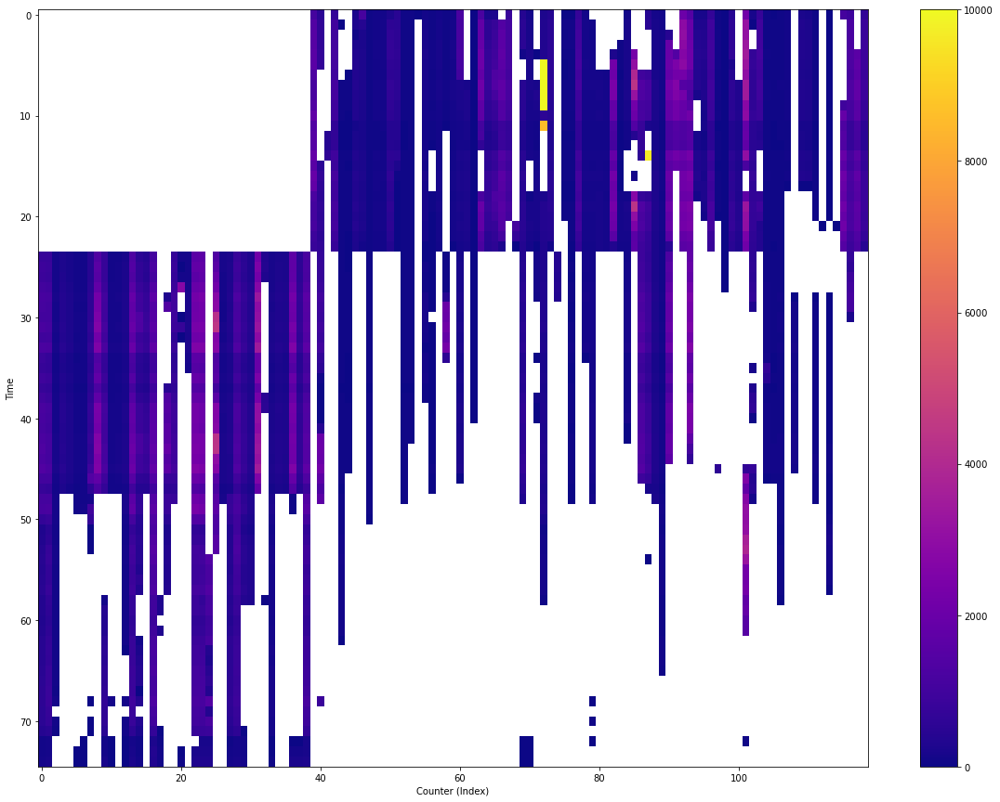

In [17]:
counts_per_counter = counts[counts.DayType == "Weekday"].groupby(["Location", "Year", "Month"]).Count.mean().reset_index()
counts_per_counter = counts_per_counter.pivot(index=["Year", "Month"], columns="Location")
counts_per_counter = counts_per_counter.reindex(months,level=1)
counts_per_counter = counts_per_counter.replace(0, np.nan)
counts_per_counter = counts_per_counter.dropna(axis=1,how="all").droplevel(0, axis=1)

plt.figure(figsize=(20,15))
plt.set_cmap("plasma")
plt.imshow(counts_per_counter, aspect="auto", vmin=0, vmax=10000)
plt.colorbar()
plt.xlabel("Counter (Index)")
plt.ylabel("Time")
plt.show()

The plot shows the overall coverage of the data in the counts. The vertical bars are each individual counters, while the height at which the individual pixel is at is a month-and-year over the dataset's coverage. We see an overview of how long these counters were in service, how many are still active now (the bottom row of pixels), and we also see the values of them in their color. From this, we took note of the large amount of NaN- or 0-values, which we treated as invalid or incorrect counts in all future analysis.

We set the limit rather high at 10,000 to see if we could spot any set of outliers. Indeed, we see that there are a few extreme 10,000+ pixels. To take a closer look at the distribution of the Counts dataset, we did both a histogram as well as a box plot, however only the box plot was even _somewhat_ readable:

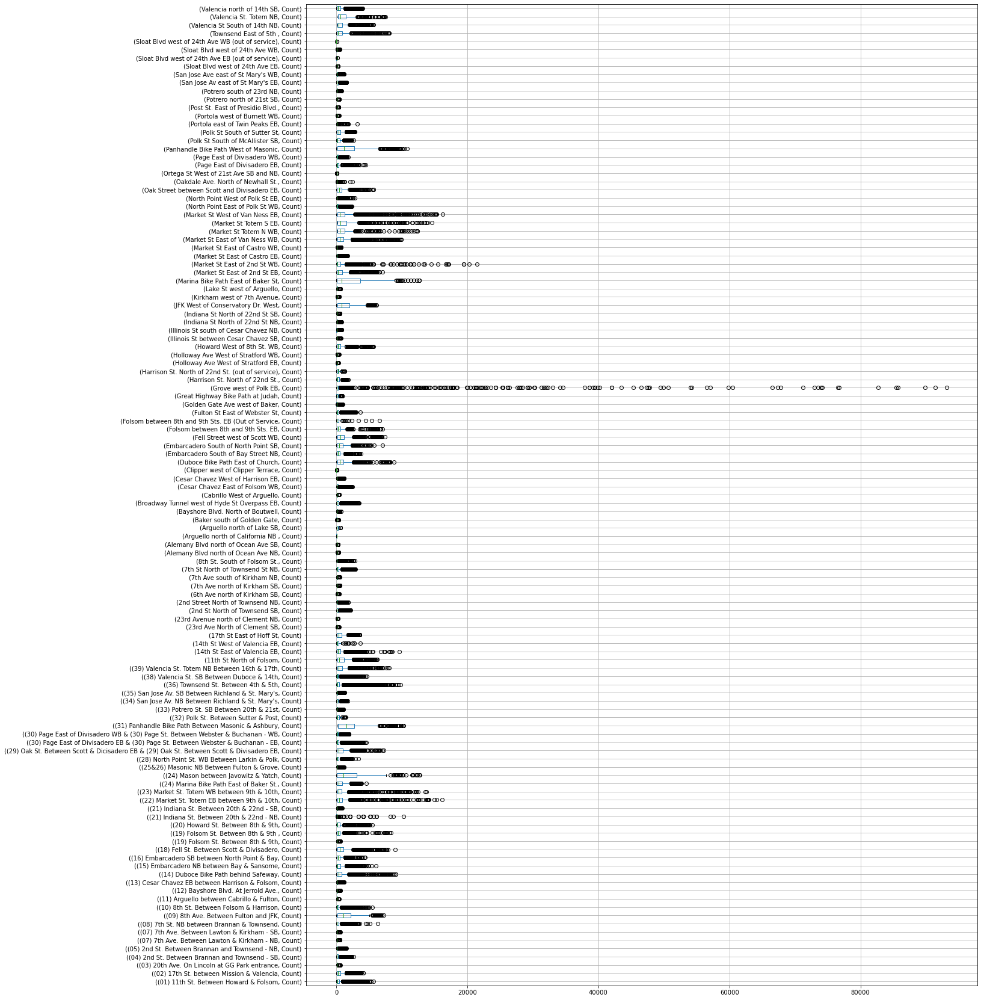

In [18]:
counts.replace(0, np.nan).dropna().groupby("Location").boxplot(column="Count", subplots=False, figsize=(20,30), vert=False);

Even though you can't properly read it, it was clear that some counters had _extremely_ high outliers, up in the 80,000 bicyclists _in a single hour_. That's 22 bicyclists every _second_. That's like Tour de France levels of bikers. Perhaps these counts were measured in some kind of bike race, indeed. In either case, we decided to _cut_ the data off at a 10,000 limit. That's still extremely high, but it would not make sense to limit lanes too heavily, as the numbers do fluctuate drastically given the day/night differences of these counts.

We performed the cleaning, and the output fell to this:

In [19]:
counts = counts[counts.Count < 10000]
counts.shape

(204882, 7)

# Data Analysis

The centerpoint of the analysis was to figure out correlations between the lanes and their respective bike ridership counts. We already saw the exploratory plot of the bike lanes vs. the bike count growth, but we wanted to see how this extended into the automatic counts beyond 2017, too. However these automatic counts weren't counted in the same way, and thus wouldn't fit to scale. Instead, we had to analyze our way to something that would allow them to align.

Since the automatic counts overlapped with the manual ones for 2016 and 2017, we could take the *relative change* in the automatic counts over the years, and scale that to the level that the *manual counts* used. For example, if 2018 was 50% larger than 2017 according to the *automatic counts*, then, we can assume that the counts of the automatic counters and the manual counters are proportional in the years they overlap, and adjust the scaling by this proportion.

On top of that, we wanted to see if we could find a linear proportion between the bike lane growth and the bike count growth, since it was clearly not 1:1 in the previous plot (bike growth much steeper). To accomplish this, we plotted the two up against each other *on two separate y-axes*. This let us scale them independently, to cancel out proportional changes. As long as they both started at 0, it would be a linear proportion.

Together, this gave us the below updated version of the plot below:

In [20]:
# This is the same plot as the one done in the exploratory analysis section, however updated with
# the automatic counts and the separate y-axes. While a lot of the code in this block is a copy of
# the above, the comments will be rewritten, and will highlight the differences

p = figure(width=950, height=500)

network_growth = network.groupby("install_yr")["length"].sum().cumsum().reset_index()
network_growth = network_growth.set_index("install_yr")
network_growth.index = network_growth.index.astype(int)
network_growth = network_growth.drop(range(0,2000), errors="ignore")
l1 = p.line(x=network_growth.index, y=network_growth.length, line_width=2, legend_label="Bike Network Growth")

# Here we add the second axis for the plot, and also tinker with the range of the first.
# By trial and error, we found the ranges of (0-750) and (0-1500) to fit well, implying a 2:1 proportion
p.y_range = Range1d(0, 750)
p.extra_y_ranges = {"BikeVol": Range1d(start=0, end=1500)}
p.add_layout(LinearAxis(y_range_name="BikeVol", axis_label="Bike Volume"), 'right')

# This is the same percent change calculations, EXCEPT now we use the mean of the
# starting year as the starting point, rather than 1. This was a simple change that projects
# it right back into the real count, while retaining the same benefit as before.
# (Also, it was just easy to change)
volume_growth_manual = manual_counts[yearlist]
volume_growth_manual = volume_growth_manual.pct_change(axis=1).mean()
volume_growth_manual += 1
volume_growth_manual[2006] = manual_counts[2006].mean() # <-- This is the changed line
volume_growth_manual = volume_growth_manual.cumprod()
l2 = p.line(x=range(2006,2018), y=volume_growth_manual, color="orange", line_width=2, legend_label="Bike Volume (Manual Count)", y_range_name = "BikeVol")

# Now for the automatic counts
# We chose to grab just the means for the prime-time of 17:00 on a weekday, as the manual counts
# were also conducted during peak hours. We excluded year 2022 as the imcompleteness of this
# data heavily skyrocketed, which didn't paint the right picture
volume_growth = counts[(counts.Year != 2022) & (counts.Hour == 17) & (counts.DayType == "Weekday")].groupby(["Location", "Year", "Month"])["Count"].mean()
volume_growth = volume_growth.reindex(months, level=2)
volume_growth = volume_growth.replace(0, np.nan)

# Here's an important step: The pct_changes are clipped to -0.9 and 10, meaning outliers of
# sudden 90% fall in bike riders, or 10x rise are limited to that. These may be cases
# where a lane might have closed due to construction work or other reasons, causing drastic dips.
volume_growth = volume_growth.groupby("Location").pct_change(fill_method=None).clip(-0.9, 10)
volume_growth = volume_growth.groupby("Year").mean()
volume_growth += 1
volume_growth[2016] = volume_growth_manual[2016] # <-- We set its initial starting point to match that of the manual growths
volume_growth = volume_growth.cumprod()
l3 = p.line(x=range(2016,2022), y=volume_growth, color="orange", line_width=3, line_dash="dashed", legend_label="Bike Volume (Automatic Count - Scaled to Fit)", y_range_name = "BikeVol")

p.legend.location = "top_left"
show(p)

Now we have something that looks somewhat fitting. And we see that the trend of growth continues nicely with the jump to the automatic counts.

## Bike Lane Class Correlations
The analysis then moved on to try and investigate the potential correlations (or maybe eventual lack thereof!) between the lane classes and the usage they see. First up was a simple overview of how much percentage each lane held of the entire network:

In [21]:
# We can just reuse the final distribution of classes from the Bike Network Expansion plot made earlier
# The last row is equal to the final sum, already separated by classes
class_distribution = network_growth_classes.iloc[-1].reset_index().set_index("facility_t")
class_distribution.columns = ["Length"]
class_distribution['Percent'] = class_distribution['Length']/class_distribution['Length'].sum()
class_distribution

,Length,Percent
facility_t,,
CLASS I,57.958923,0.133973
CLASS II,135.111629,0.312312
CLASS III,196.907250,0.455154
CLASS IV,42.639358,0.098561


That gave a nice insight into the basis of the network, and its distribution. This is the same as we saw on the Class Growth plot higher up in the exploratory analysis.

**Then we wanted to see how the counts looked across these classes.** This was plotted up with a bar chart, letting us see the proportion of the average bike volume between each of the classes.

In [22]:
# Firstly, we need to get the values of all the counters that are relevant to us.
# We limit ourselves to one year (2019 chosen as the most recent year with a stable average).
# Here we then filtered out NaN and 0-values, and finally we only took those counts for whom
# we have an entry in the "counters" table. This limits us to only work with those we know the location,
# and thereby, the Lane Class of
bar_vals = counts[counts["Year"] == 2019]
bar_vals = bar_vals[~bar_vals["Count"].isnull()]
bar_vals = bar_vals[bar_vals["Count"] > 0]
bar_vals = bar_vals[bar_vals["LocationMapped"].isin(counters.location)]

# Now we group by the Location and get the means across the whole year. We remember to
# also group by the DayType so we can separate Weekday from Weekend
bar_vals = bar_vals.groupby(["LocationMapped", "DayType"])["Count"].mean().reset_index()

# Merge it with the "Class" column in our "counter_lanes" table we derived earlier, then group by this class and get the mean
bar_vals = bar_vals.merge(counter_lanes[['Location', 'Class']], left_on='LocationMapped', right_on='Location', how='left')
bar_vals = bar_vals.groupby(["Class","DayType"]).mean()

# Since we already chose a colorset, we wanna make sure this fits those colors
bar_vals["Color"] = np.repeat(class_colors,2)
cds = ColumnDataSource(bar_vals)

bar = figure(width=650,height=400, x_range=FactorRange(*bar_vals.index))
b1 = bar.vbar(x='Class_DayType', top='Count', source=cds, width=0.85, color='Color')

bar.yaxis.axis_label = "Bike Volume"
show(bar)

We can see that the proportions are heavily in favor of Class I, followed by IV. With having done the research on what each class of lane is [here](https://www.sfmta.com/getting-around/bike/bike-improvements-toolkit), this makes total sense. What *was* interesting though, was that we see a clear proportional difference in the **Weekend** of Class I and Class IV, relative to their Weekday counterparts: The weekend on Class I is more than twice as big as Class IV, even though the weekday definitely is *not* twice as big.

This gives insight that Class I are much more commonly chosen amongst leisure rides, that you might expect when not going to work. Again, knowing what Class I lanes are from the same source, it makes a lot of sense, but it's not something you really see until you look at these bars more closely.

### Bike Lane Class Before-and-After

This step of the analysis was the one that was the centerpiece of it all. We wanted to see whether the construction or updating of a lane into a new class, saw a significant difference in growth depending on what class of lane it was upgraded into. In order to do this though, we first had to go back to the preprocessing and add the *PredatesLaneInstall* and *PredatesLaneUpdate* columns to the **Counter Lanes** table. This is what prompted the [**"Later, ..."** second bullet in the Counter Lanes preprocessing section](#Counter-Lanes).

After that was done, we could fetch those counters only where they had data available both before and after the construction or update of their lane:

In [23]:
predating = counter_lanes[counter_lanes.PredatesLaneInstall | counter_lanes.PredatesLaneUpdate]
predating

,CounterIndex,Location,Automatic,Lane,Class,District,PredatesLaneInstall,PredatesLaneUpdate
0,0,Fell Street west of Scott WB,True,2006,CLASS IV,NORTHERN,False,True
5,5,2nd St North of Townsend SB,True,485,CLASS IV,SOUTHERN,False,True
6,6,Valencia St. Totem NB,True,5133,CLASS II,MISSION,False,True
8,8,Townsend East of 5th,True,5015,CLASS IV,SOUTHERN,False,True
18,18,Valencia north of 14th SB,True,5118,CLASS IV,MISSION,False,True
26,26,Folsom between 8th and 9th Sts. EB,True,2023,CLASS IV,SOUTHERN,False,True
28,28,Clipper west of Clipper Terrace,True,1693,CLASS IV,MISSION,False,True
31,31,8th St. South of Folsom St.,True,791,CLASS IV,SOUTHERN,False,True
35,35,San Jose Ave east of St Mary's WB,True,4542,CLASS IV,INGLESIDE,False,True
42,42,Market St West of Van Ness EB,True,3316,CLASS IV,SOUTHERN,False,True


Unfortunately, since no *Class I* lanes were ever constructed within our scope according to the dataset's limited Installation Year variables, we could not get any Class I to show up in here. We did, however, find a fair few that would work.

By iterating through this, we could build up a DataFrame in which we would have the before and after values of each counter- or manual count location. As some lanes' counts went to 0 right after or during the construction (perhaps _because_ the construction?), we cut off those where we saw a drop by more than 75%. 

In [24]:
# Construct the Before/After DataFrame by building the list of Rows
data = []
for i,r in predating.iterrows():
    
    # If this counter predates the lane install, then we must look into those years
    if r.PredatesLaneInstall:
        year = network.iloc[r.Lane].install_yr
        
        # If it's automatic or manual, it changes how we get the numbers for that year.
        # For automatics, it's by grouping the counts where the location is the same, and getting the mean
        # of the year at the peak hours (just like manual count).
        if r.Automatic:
            group = counts[(counts.LocationMapped == r.Location) & (counts.DayType == "Weekday")].groupby("Year").Count.mean().replace(0, np.nan).dropna()
            
            # If the counter has data in both of these years
            # And only if this data isn't a sudden drastic drop, then
            if year - 1 in group and year + 1 in group:
                if group[year+1]/group[year-1] > 0.25:
                    data.append([r.Location, r.Class, group[year-1], group[year+1]])
                    
        # For manual counts, it's already yearly numbers, so we just need to find the row for it
        # Then do the same
        else:
            count = manual_counts.iloc[r.CounterIndex]
            if year - 1 in count and year + 1 in count:
                if count[year+1]/count[year-1] > 0.25:
                    data.append([r.Location, r.Class, count[year-1], count[year+1]])
    
    # All of this is also done for those that predates an update, only here we look at the update year
    if r.PredatesLaneUpdate:
        year = network.iloc[r.Lane].update_yr
        if r.Automatic:
            group = counts[(counts.LocationMapped == r.Location) & (counts.DayType == "Weekday")].groupby("Year").Count.mean().replace(0, np.nan).dropna()
            if year - 1 in group and year + 1 in group:
                if group[year+1]/group[year-1] > 0.25:
                    data.append([r.Location, r.Class, group[year-1], group[year+1]])
        else:
            count = manual_counts.iloc[r.CounterIndex]
            if year - 1 in count and year + 1 in count:
                if count[year+1]/count[year-1] > 0.25:
                    data.append([r.Location, r.Class, count[year-1], count[year+1]])
                    
predates = pd.DataFrame(data, columns=["Location", "Class", "Before", "After"])
predates

,Location,Class,Before,After
0,Fell Street west of Scott WB,CLASS IV,1374.694444,1336.911458
1,Valencia St. Totem NB,CLASS II,1442.684028,1318.086806
2,Folsom between 8th and 9th Sts. EB,CLASS IV,885.625000,1293.643939
3,8th St. South of Folsom St.,CLASS IV,522.791667,904.987847
4,Market St West of Van Ness EB,CLASS IV,1543.329787,1510.838235
5,Howard West of 8th St. WB,CLASS IV,914.538194,853.725694
6,Oak Street between Scott and Divisadero EB,CLASS IV,883.885417,1030.960069
7,Polk St & Sutter St,CLASS III,203.000000,336.000000
8,Valencia St & 17th St,CLASS II,771.000000,1172.000000
9,Marina Blvd & Cervantes Blvd,CLASS III,625.000000,613.000000


Now we could plot this together in a slope chart just like we made in Assignment 2, to see what this looks like as a whole. We apply the same colors, and get the following plot:

In [25]:
p = figure(width=700,height=500, x_range=(-0.25,1.25))
p.add_layout(Legend(), 'left')

for i,r in predates.iterrows():
    p.line(x=[0,1],y=[r.Before, r.After],color=class_color_map[r.Class], line_width=3, legend_label=r.Class)
    p.circle(x=[0,1],y=[r.Before, r.After],color=class_color_map[r.Class], line_width=2, size=8, legend_label=r.Class)
    
p.ygrid.grid_line_color = None
p.xaxis.ticker = [0,1]
p.xaxis.major_label_overrides = {0: 'Before Bike Lane Construction', 1: 'After Bike Lane Construction'}
p.legend.location = "top_left"
p.yaxis.axis_label = "Average amount of bicyclists"

show(p)

It does look really promising, but we needed to see the averages to really tell. So by grouping these values by class and taking the means of that, we get the following:

In [26]:
p = figure(width=700,height=500, x_range=(-0.25,1.25))
p.add_layout(Legend(), 'left')

for i,r in predates.groupby("Class").mean().reset_index().iterrows():
    p.line(x=[0,1],y=[r.Before, r.After],color=class_color_map[r.Class], line_width=6, legend_label=r.Class)
    p.circle(x=[0,1],y=[r.Before, r.After],color=class_color_map[r.Class], line_width=4, size=12, legend_label=r.Class)
    
p.ygrid.grid_line_color = None
p.xaxis.ticker = [0,1]
p.xaxis.major_label_overrides = {0: 'Before Bike Lane Construction', 1: 'After Bike Lane Construction'}
p.legend.location = "top_left"
p.yaxis.axis_label = "Average amount of bicyclists"

show(p)

Even if the number is already high, the difference in before-and-after is almost twice as large as Class IV as it is on Class II and III. This indicates that there is in fact a difference between the classes. However, as far as proportions go, it could easily even out. Since the numerical value of Class IV is just about twice as high, and the growth is also just over twice as much, it is hard to exactly say that this difference is significant enough to not just have been caused by whatever other factor led to the high volume in the first place.

That ultimately had to be the conclusion on this analysis.

## Machine Learning

Towards the end of the project, we wanted to include a bit of machine learning in what way we could with the posed question. The idea was to attempt to predict how much usage a lane would get, if it was constructed given a specific position in the city and class. If this could work, the model at the end of it could 

This is a **Regression** problem. The predictor here would be the *Count* variable in the Counts table. For the predicting *features*, we had all the options of the various features in the Bike Network dataset, as well as the variables in the Counts. Originally, _Hours_ and _Months_ were included as features, such that the prediction would be made based on what time of day and what month of year the value is predicted to be in. However, these were ultimately chosen against, and rather using some type of average, because of the fact that the idea was to predict more long-term numbers, that wouldn't really make much sense to have to specify a precision down to the hour to make.

#### Making full use of the Dataset

Since the data would be extremely limited if only counts from the current year was used, we instead made use of the full dataset by dividing each count's value by the global mean in that specific frame of time. This changed the prediction domain to be "predicted amount of means this lane will have". This puts all counts on the same scale, making it more about the proportion of differences between the locations and classes that impact the prediction, than the differences in what hour, month, or year it was taken in.

The preprocessing of the data is done as such below:

In [27]:
# Preprocessing the data, for machine learning!

# This parameter controls what domain we want to predict averages across
prediction_domain = ["Year", "DayType"]

# Pull data from ALL counts, but normalize it to the mean of that year, in that month, in that daytype
# We're only interested in generalizing some estimate for longer-term, so we don't need to care about the hour of day
# We also wanna drop the odd THURSDAY, FRIDAY, SATURDAY... daytypes, since they are underrepresented (and not very relevant)
counts_train = counts[(counts.DayType.isin(set(["Weekday", "Weekend"]))) & (counts.Count > 0)].groupby(["LocationMapped"] + prediction_domain).Count.mean().reset_index()
counts_train = counts_train[counts_train.LocationMapped.isin(counter_lanes.Location)]

# Normalize all the counts so that we have the same scale across all years
# Each count should be relative to the global mean within that domain's timeframe
normalize_group = counts_train.groupby(prediction_domain).Count
counts_train["Count"] = counts_train.Count/normalize_group.transform("mean")
counts_train = counts_train[(counts_train.Count > 0.1) & (counts_train.Count < 10)] # Just like before, we cut off extreme outliers

# Now we want to augment additional data based on the location
# This include: Class, District, Lat, Lon
# Merge it in from the other DataFrames we got
counts_train = counts_train.merge(counters[['location','lat', 'lon']], left_on='LocationMapped', right_on='location', how='left')
counts_train = counts_train.merge(counter_lanes[['Location','Class','District','CounterIndex']], left_on='LocationMapped', right_on='Location', how='left')

# Encode our categorical columns with One-Hot
counts_train = pd.concat((counts_train, pd.get_dummies(counts_train["Class"])), axis=1)
counts_train = pd.concat((counts_train, pd.get_dummies(counts_train.District)), axis=1)

# Encode DayType with a LabelEncoder
labelencoder = LabelEncoder()
counts_train["Weekend"] = labelencoder.fit_transform(counts_train["DayType"])

# Drop all the encoded, as well as duplicate columns used from the merging and processing
counts_train = counts_train.drop(["CounterIndex", "Location", "location", "LocationMapped", "Year", "Class", "District", "DayType"], axis=1).rename(columns={"LocationMapped": "Location", "lat": "Lat", "lon": "Lon"})

# Now get our target out, and we have the datasets
counts_val = counts_train.pop("Count")
counts_train

,Lat,Lon,CLASS I,CLASS II,CLASS III,CLASS IV,BAYVIEW,CENTRAL,INGLESIDE,MISSION,NORTHERN,PARK,RICHMOND,SOUTHERN,TARAVAL,TENDERLOIN,Weekend
0,37.77248,-122.41468,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0
1,37.77248,-122.41468,0,1,0,0,0,0,0,0,0,0,0,1,0,0,1
2,37.77248,-122.41468,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0
3,37.77248,-122.41468,0,1,0,0,0,0,0,0,0,0,0,1,0,0,1
4,37.77248,-122.41468,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
607,37.768673,-122.42225,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0
608,37.768673,-122.42225,0,0,0,1,0,0,0,1,0,0,0,0,0,0,1
609,37.768673,-122.42225,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0
610,37.768673,-122.42225,0,0,0,1,0,0,0,1,0,0,0,0,0,0,1


Now we split the data into a training and test set so we can evaluate its performance later:

In [28]:
# Split the data
train_features, test_features, train_outputs, test_outputs = train_test_split(counts_train, counts_val, test_size=0.3, random_state=42)

### Choosing a Model

Since we only worked with a *Classification* task prior to this assignment, we did not know which type of Regression model was best for our task. So we took all the ones we could find, initialized them, and then plotted their errors together in histograms to see how well they performed side-by-side.

All models were initialized with default parameters to begin with, but the most interesting ones were tinkered with a little bit to see how far they could improve. The histograms that came out as a result displays the amount of predictions each made within an **_error range_**, where the error is given by how many "means" it was off the correct value in the test set.

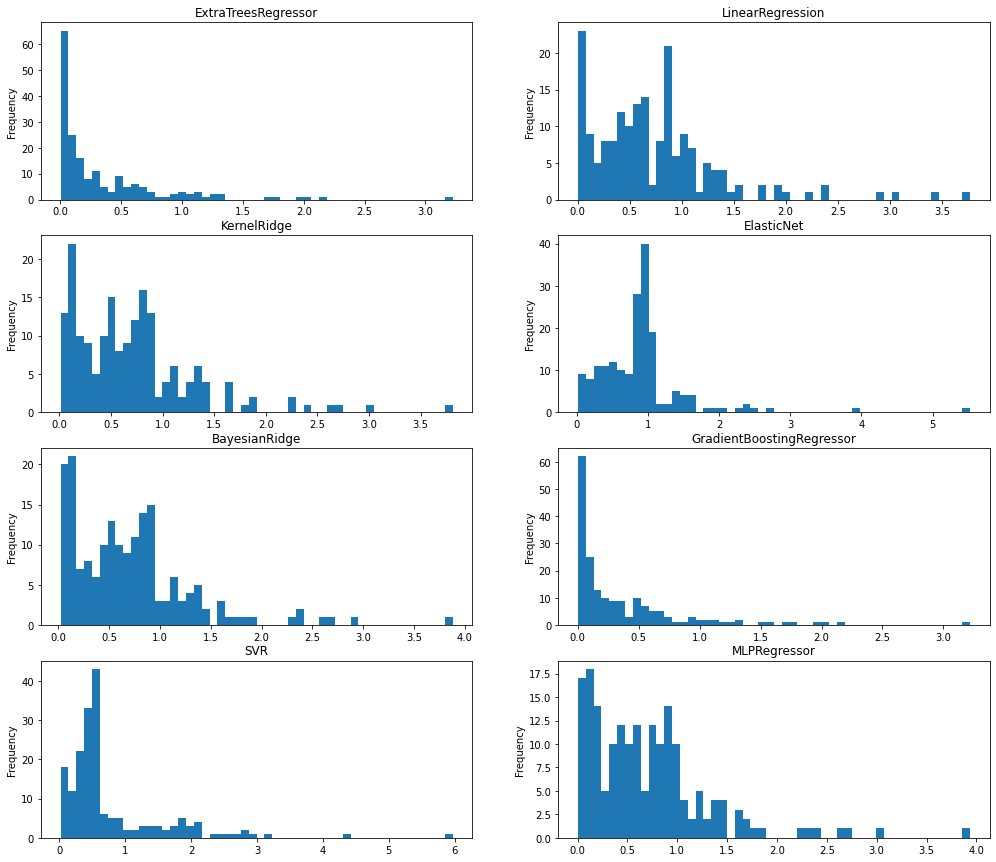

In [29]:
# Chose a fitting model
from sklearn.linear_model import LinearRegression, SGDRegressor, ElasticNet, BayesianRidge
from sklearn.kernel_ridge import KernelRidge
from sklearn.ensemble import ExtraTreesRegressor, GradientBoostingRegressor
from sklearn.svm import SVR
from sklearn.neural_network import MLPRegressor

# Initialize our models. The SGDRegressor was disabled due to being so inaccurate, it wasn't even readable
models = [
    ExtraTreesRegressor(),
    LinearRegression(),
    #SGDRegressor(),
    KernelRidge(),
    ElasticNet(),
    BayesianRidge(),
    GradientBoostingRegressor(learning_rate=1), # This one had its learning_rate tinkered with
    SVR(),
    MLPRegressor(max_iter=200000, learning_rate_init=0.01) # The MLP Regressor was given many iterations to attempt to learn with
]

fig, axs = plt.subplots(ncols=2, nrows=int(math.ceil(len(models)/2)), figsize=(17,15))
for i,m in enumerate(models):
    m.fit(train_features, train_outputs);
    y_pred = m.predict(test_features)
    
    s = pd.Series(abs(y_pred - test_outputs))
    s.plot.hist(bins=50, ax=axs[int(math.floor(i/2))][i%2], title=type(m).__name__)

We found that the **GradientBoostingRegressor** seemed to perform the best. Taking that model, we then went on with a **RandomizedCVSearch** for the best hyperparameters for the model, just as we had done in prior assignments, however the results varied so much while not impacting performance, that we went with what ultimately worked the best when plotted later on the map (The last of the Visualizations).

In [30]:
model = GradientBoostingRegressor()
parameter_grid = {
    'learning_rate': [0.001, 0.0001, 0.01, 0.05, 0.1, 0.2, 0.3, 0.5, 0.7, 1.0],
    'n_estimators': [5, 10, 25, 50, 100, 200, 300, 400, 500, 600, 700, 800, 900, 1000],
    'max_depth': [2, 3, 5, 10, 20, 30, 40, 50, 75, 100],
    'max_features': ['auto', None],
    'min_samples_leaf': [1, 2, 5, 10],
    'min_samples_split': [2, 3, 5],
}

#Build the Cross-Validation model on this forest
model_parameters = RandomizedSearchCV(estimator=model, param_distributions=parameter_grid, n_iter=100, cv=3, verbose=1, random_state=42);

# Fit it to the data (Run)!
model_parameters.fit(train_features, train_outputs);

# Let's view the final parameters!
model_parameters.best_params_

Fitting 3 folds for each of 100 candidates, totalling 300 fits


{'n_estimators': 50,
 'min_samples_split': 2,
 'min_samples_leaf': 2,
 'max_features': None,
 'max_depth': 5,
 'learning_rate': 0.05}

In [31]:
# Just make a model with tinkered attributes that seem to result in a good outcome
model = GradientBoostingRegressor(n_estimators=300, max_depth=5, learning_rate=0.1)

# Get our output now
model.fit(train_features, train_outputs)
y_pred = model.predict(test_features)

We could then plot its performance using a box plot just like the one above. This gave us an insight into the model's final performance.

In [32]:
### Histogram figure time!
perror = figure(width=700,height=500)
perror.add_layout(Legend(), 'left')

# Get the histogram out from 0-3 across 30 bins
error_hist = np.histogram(abs(y_pred - test_outputs), np.linspace(0,3,30))

# Calculate the values and insert!
perror.vbar(x=(error_hist[1][1:] + error_hist[1][:-1])/2, top=error_hist[0], width=3/30)

# Format the figure!
perror.xaxis.axis_label = "Error"
perror.yaxis.axis_label = "N. Predictions"

print(f'Mean error: {np.mean(abs(y_pred - test_outputs))}')
show(perror)

Mean error: 0.3381235208798082


And this was about the best we could get. Not that bad, with quite a lot of predictions landing in the <10% of the mean error, which for a year of a mean of 600 bicyclists means it's predicting the correct number within a range of 60 people. That said, we see that there is even a place where it predicts 3 times the mean too far. That would mean it's about 1800 too high or too low.

So to evaluate, not the best performing model, but also not too bad. We concluded after extensive analysis and trials, that it was likely due to the limited dataset. Additional features, such as the *vehicle* traffic of the lanes, which isn't present in this model's predictions but may very well be large factors in real-life bicycle usage, could cause the inaccuracy here. Our model could be suffering from **Omitted Variable Bias** and possible **Societal Bias**, if campaigns and the like may have influenced the datapoints. A hugely-impacting omitted variable could be **Population Density.** There is also **Sample Bias** in that the majority of counters lie deeper in the city, and several districts have very few or even none.

### Feature Importances

We were still able to extract the feature importances of the model. This could give insight into some of the patterns in the data, from at least what is present. We plotted this down in a plot similar to what we've done before, and reached the outcome:

In [33]:
# Feature Importance Figure
pimportance = figure(width=500,height=500)

### Calculate the values and insert into the figure
std = np.std([tree[0].feature_importances_ for tree in model.estimators_], axis=0)
pimportance.hbar(y=range(0,len(test_features.columns)), right=model.feature_importances_, height=0.3, color="lightblue")
for i,s in enumerate(std):
    pimportance.line(x=[max(model.feature_importances_[i]-s, 0), model.feature_importances_[i]+s], y=[i,i], line_width=3, line_dash='dashed', line_cap="round", legend_label="Std. Deviation")
    
pimportance.circle(y=range(0,len(test_features.columns)), x=model.feature_importances_, size=10)
pimportance.text(y=range(0,len(test_features.columns)), x=model.feature_importances_, text=[f'{n*100:.2f}%' for n in model.feature_importances_], text_align='center', y_offset=-4, x_offset=6, text_font_size={'value': '10px'})


# Format our figure
pimportance.yaxis.ticker = list(range(0,len(test_features.columns)))
pimportance.yaxis.major_label_overrides = {i: test_features.columns[i] for i in range(0,len(test_features.columns))}
pimportance.ygrid.grid_line_color = None

pimportance.xaxis.axis_label = "Importance"
show(pimportance)

As suspected, the position matters more than any other variable, indicating that the bicyclist count really comes down to where in the city you are, which would make sense with population density. Perhaps if population density was able to be included Latitude and Longitude would have a much lesser effect.

We see that Class I has the largest impact of the 4 classes, followed by II and III respectively, with IV being the lowest-impacting one. That could be because Class IV is the one closes to the mean, while Class I drags it up a lot, and Class II may drag it down a fair bit. The Districts also seem to have some impact, likely Richmond being a quieter residential area causing a big downwards impact on the predicted result. Weekend had less of an impact than Richmond, however a larger standard deviation meaning some trees in the model had it higher.

**All in all, the final outcome of the model was not very accurate given the data we had limited ourselves to.**

# 4. Genre
The final genre used in the web post is an **Interactive Slideshow** genre. It contains ordered graphs that tell an author-driven narrative, but with interactive elements in each where the reader can stop and inspect or play around with the data, before moving on with the story. This genre turned out to be perfect, as we wanted to guide the viewer through this question of *"What came first: The Chicken or the Egg?"*, but always making the viewer feel like they are part of it and that it's almost as if they a very part of the analysis, simply through letting them take it at their own pace, and really investigating the data inbetween every narrative part. Towards the end, it approaches a bit more of a **Martini Glass Structure.** The final visualization poses a big sandbox for the reader to play around with, and really investigate the results of their little analysis project.

### Visual Narrative Tools Used
The following are the visual narrative tools used in each category inside the Visual Narrative table in the reading list.
* **Visual Structuring:** The "Consistent Visual Platform" was used. This is in part seen in the consistent colors across the many diagrams. Classes all are identified by the same 4 colors, and even Weekdays and Weekends are differentiated by the same purple-and-green color scheme. This helps the reader feel familiar with the topic as they go along, making it all feel connected.
* **Highlighting:** "Feature Distinction", "Motion", and "Zoom" were used across the many diagrams. Feature Distinction was done through the color mapping and different line styles in the plots. Zoom and Motion were used in animated charts, where the reader can zoom themselves, and motion is seen through the animating geometry.
* **Transition Guidance:** "Familiar Objects" connected the transitions. This is through consistent color scheme as well. Just like the visual structuring, the purpose of this was to make sure the reader feels the connection through the narrative in the visual representations.

### Narrative Structure Tools Used
* **Ordering:** The ordering was half "Random Access" and half "Linear". In the over-arching form, the narrative ordering was linear, as the reader was driven through the story. However some parts, such as the *time patterns* and *geographic patterns* could be read in any order, as long as you still followed the overall order on the higher-level headlines. This divided the topic into smaller, more congestible bites while keeping an overall story flowing.
* **Interactivity:** "Hovering Highlighting/Details", "Filtering/Selection/Search", and "Explicity Instruction" were all used for interactivity. All plots (where it was possible) supported some kind of hovering or clicking, and many had filtering through the means of clicking the legend box or choosing a different tab. Explicit instruction was provided in the text above and below.
* **Messaging:** "Accompanying Article" and "Introductory Text" brought the whole message together. The whole story was put together in an accompanying article, which started off grabbing the reader's interest in the introduction section at the very top - the one that posed the interesting question. This really wrapped up the post as one package that made it really easy to consume.

# 5. Visualizations
In this section, we will go over all the final visualizations that were used in the article. Note, as some of the plots were similar to the ones above, we will not go over the methodology in detail where it repeats. Instead, we will only briefly discuss the differences, and refer up to the methodology text above.

After building a story arc over the analysis, the plots were structured into three different sections and given an order, and that is the order we will walk through them here now.

## Section 1: Introductory Data Presentation
The initial section in the article serves to introduce the reader to the datasets in interesting, visual ways.

### A) An overall map of all the Data
To begin with, we wanted to introduce the reader to the data as a whole. We created an *interactive map* in which all the geo-spatial data used in the dataset was shown. This includes the **Bike Network**, **Manual Count Locations**, **Automatic Counters**, and **Police Districts**. The simple idea was to get the reader familiar with what we were about to analyze in a spatial way.

In [34]:
# VIZ 1: The map of the Bike Network
# This map is intentionally not colored by classes. This is because the reader isn't introduced to the classes yet.
# The map also contains counting locations, as well as coloring for both of them depending on automatic/manual
bikemap = folium.Map(location=[37.765, -122.44], zoom_start=13)

# We use Feature Groups to group the geojson data together in named layers the reader can toggle
# Only the Bike Network one is shown by default
fg = folium.FeatureGroup("Bike Network").add_to(bikemap)
folium.GeoJson(data="Data/SanFrancisco/MTA.bikewaynetwork.geojson", popup=folium.GeoJsonPopup(
    fields=['streetname', 'length', 'install_yr', 'update_yr', 'facility_t'],
    aliases=['Street Name', 'Length (Miles)', 'Install Year', 'Update Year', 'Lane Class'])).add_to(fg)

# We add the Districts next. Notice that the "show" variable is False.
fg = folium.FeatureGroup("Districts", show=False).add_to(bikemap)
folium.GeoJson(data="Data/SanFrancisco/Current Police Districts.geojson", style_function = lambda x: {"color": "black", "fillOpacity": 0.05, 'opacity': 0.5}, popup=folium.GeoJsonPopup(fields=['district'], aliases=['District'])).add_to(fg)

# Automatic counters, which display the installation year
fg = folium.FeatureGroup("Automatic Counters (2016-Present)", show=False).add_to(bikemap)
for i,counter in counters.iterrows():
    folium.CircleMarker([counter.lat, counter.lon], color="red", fill_alpha=0.5, fill_color="red", tooltip=f'{counter.location} (Automatic Bike Counter - Installed: {counter.install_date.year})').add_to(fg)

# Manual Count Locations, which display the year at which they were active
fg = folium.FeatureGroup("Manual Count Locations (2006-2017)", show=False).add_to(bikemap)
for i,counter in manual_counts.iterrows():
    if counter.first_year > 0:
        folium.CircleMarker([counter.geometry.y, counter.geometry.x], color="green", fill_alpha=0.5, fill_color="green", tooltip=f'{counter.location} (Manual Count Location - Counted: {counter.first_year:.0f}-{counter.last_year:.0f})').add_to(fg)

# We add the LayerControl overlay to it finally, so the reader can toggle the features
folium.LayerControl().add_to(bikemap)
folium.plugins.MousePosition().add_to(bikemap)
bikemap

### B) Bicycle Patterns in San Francisco (Temporal Patterns)
With the data introduced, we now wanted to pique the reader's interest by showing some quick-and-easy statistics about the bike usage. Something they'd be able to understand very quickly and agree with, so it felt like this article was building up to something more interesting.

We grouped the Counts data together by the hour and the type of day, and plotted it together for a temporal count diagram. Next to it, we plotted a similar chart, this time as a _bar diagram_ for variety, the temporal patterns across the _months_ of the year. The intention was to group these together rather than split them into two linear-narrative plots, so that the reader could explore them at their own pace (Interactive Slideshow + Random Access Ordering) before continuing.

For the data analysis in section, we simply took the counts data separately on weekdays and weekends, limiting ourselves to 2019 (as mentioned before, the most recent stable collection year), and then took the mean across those groups. Plotting them together in a line gave the first plot. The second plot was done the exact same way, except limiting to 2019 _and_ weekdays, then grouping by month instead of hour.

In [35]:
### Visualization 2: Temporal Patterns in Biking
# Show the correlation between hour-of-the-day and month-of-the-year together with the amount of bike riders
# This plot should be easy to understand, and act as an "easing in" into the deeper topics
p = figure(width=550, height=400)

# Step 1: Collect the hourly patterns of weekends and weekdays
time_means_weekday = counts[(counts.Year == 2019) & (counts.DayType == "Weekday")].groupby("Hour").Count.mean()
time_means_weekend = counts[(counts.Year == 2019) & (counts.DayType == "Weekend")].groupby("Hour").Count.mean()

# Draw a line for each
l1 = p.line(x=time_means_weekday.index, y=time_means_weekday, line_width=3, color="purple", legend_label="Weekday")
l2 = p.line(x=time_means_weekend.index, y=time_means_weekend, line_width=3, color="green", line_dash='dashed', legend_label="Weekend")

# We will put circles too, because it makes the points on the lines so much more readable
p.circle(x=time_means_weekday.index, y=time_means_weekday, line_width=2, color="purple", fill_color="white", size=8)
p.circle(x=time_means_weekend.index, y=time_means_weekend, line_width=2, color="green", fill_color="white", size=8)

# We will position the legend, and then set the ticks on the x-axis
# Then we'll overwrite them with clock timestamps
# This makes it super easy for the reader to understand, without any scientific knowledge
p.legend.location = "top_left"
p.xaxis.ticker = [0, 6, 12, 18, 24]
p.xaxis.major_label_overrides = {0: '00:00', 6: '06:00', 12: '12:00', 18: '18:00', 24: '00:00'}

# Label the plot
p.title = "Average Bicyclists by Hour"
p.xaxis.axis_label = "Time"
p.yaxis.axis_label = "Average Bicyclists"

# Finally, we'll add 2 Hovertools: One for each line. Then we can give them different tooltip texts.
# The "vline" mode makes the hovering tool work as a vertical line, i.e. hovering anywhere will show the values
# at that x-coordinate (you don't have to precise and hit the circles themselves)
p.add_tools(HoverTool(tooltips=[('Average Bicyclists on Weekend', '@y{0.2f}')], renderers=[l2], mode="vline"))
p.add_tools(HoverTool(tooltips=[('Average Bicyclists on Weekday', '@y{0.2f}')], renderers=[l1], mode="vline"))

# Now for the second half of the visualization: The monthly patterns
p_months = figure(width=400,height=400)

# Here we take the means of the months
# We will also re-order them so that the months aren't sorted alphabetically (as Pandas tries to do)
month_means = counts[(counts.Year == 2019) & (counts.DayType == "Weekday")].groupby("Month").Count.mean().reset_index()
month_means = month_means.set_index("Month").reindex(months).reset_index()

# Now we plot those as bars, and then...
col = Category20c[16]
month_cols = [col[i] for i in [1,3,5,6,7,13,14,15,9,10,11,1]]
p_months.vbar(x=month_means.index, top=month_means.Count, width=0.85, color=month_cols, line_color="black")
p_months.xaxis.ticker = month_means.index
p_months.xaxis.major_label_overrides = dict(month_means.Month)
p_months.xaxis.major_label_orientation = 0.5

# ... add a hover tool, until finally adding labels
p_months.add_tools(HoverTool(tooltips=[('Average Bicyclists on Weekday in Month', '@top{0.2f}')], mode='vline'))
p_months.title = "Average Bicyclists by Month"
p_months.xaxis.axis_label = "Month"
p_months.yaxis.axis_label = "Average Bicyclists (Weekday)"

# We can show them side-by-side using the 'row' layout generator
show(row(p, p_months))

### C) Bicycle Patterns in San Francisco (Geographic Patterns)
Similar to the above, we wanted to provide another short and quick interesting peek into the dataset, this time by trying to identify which Districts saw more bicycle usage than others. Again, we present a row of 2 plots. The first one shows the average bicycle usage for each district in the shape of a bar chart. The second shows these same values on a map, as it makes it way easier to read what they mean on there.

To give some more meaning to the bar chart, we added a bar to each district that represents the *density* of the bike network in that district. That is, the amount of miles of bike lane that each district has, for every square mile. For these two particular plots, since one was a map and the other a Bokeh plot, we could not use `row` to put them side-by-side in the Notebook. Instead, they've been made side-by-side in the website using HTML. In this explainer notebook, they will also come sequentially.

To create the **Bike Volume per District** chart, we took the means of all counts, this time grouped by Location in the Counts table. For each of these count locations, we would then append the district at which it belonged to using the Counter Lanes table, which we will then group by and average across. To collect the *bike lane density*, we then had to iterate over each lane to build up the sum of miles that they belonged to. Each district already had the `shape_area` field, which described the area of the district in square feet, so we convert that to square miles. Together, we could plot both bar groups like so:

In [36]:
# Visualization 3: Bike Volume per District plot
# This visualization was intended to give insight into the geographical areas which saw more bike usage than others
# Additionally, it was meant to provide interesting insight into whether this correlated with the amount of lanes in the district
p_districts = figure(width=900, height=500)

# Limit ourselves to the same scope as before. Group by location, and average across
# Filter out 0-values, and only take those of which we know the district (those in "counter_lanes")
district_counts = counts[(counts.Year == 2019) & (counts.DayType == "Weekday")]
district_counts = district_counts.groupby("Location").Count.mean().reset_index()
district_counts = district_counts.replace(0,np.nan).dropna()
district_counts = district_counts[district_counts.Location.isin(counter_lanes.Location)]

# Get all the Districts into the table so that we can group by that and average
# Then also sort the values so it's nice on the plot :)
district_counts["District"] = [counter_lanes[counter_lanes.Location == r.Location]["District"].iloc[0] for _,r in district_counts.iterrows()]
district_counts = district_counts.groupby("District").mean().sort_values(by="Count", ascending=False).reset_index()

# Now we iterate over all lanes to find which district they belong to, and sum up the total
# length of miles for each
district_counts["Lanes"] = 0
for i,lane in network[network["length"] > 0].iterrows():
    mindistrict = None
    mindistrict_dist = 0.1
    for _,district in districts.iterrows():
        dist = district.geometry.distance(lane.geometry)
        if dist < mindistrict_dist:
            mindistrict = district.district
            mindistrict_dist = dist
            if dist <= 0:
                break
    if mindistrict is not None:
        idx = district_counts[district_counts.District == mindistrict].index
        district_counts.loc[idx, "Lanes"] += lane.length

# We can grab the area of the district from the districts table, then do the math!
district_counts = district_counts.merge(districts[["shape_area", "district"]], left_on="District", right_on="district")
district_counts["LaneDensity"] = district_counts.Lanes/(district_counts.shape_area*3.58701e-8) # Square Feet to Square Miles

# We would need a second axis label to fit these into the same plot (else the lane density ones would be tiny)
p_districts.yaxis.axis_label = "Average Bicyclists (Weekday)"
p_districts.extra_y_ranges = {"LaneDensity": Range1d(start=-1.25, end=25.25)}
p_districts.add_layout(LinearAxis(y_range_name="LaneDensity", axis_label="Miles of Lane per Square Mile"), 'right')

# Now we add the bars
b1 = p_districts.vbar(x=district_counts.index - 0.175, top=district_counts.Count, width=0.325, color=brewer["Paired"][10], legend_label="Average Hourly Bicyclists")
b2 = p_districts.vbar(x=district_counts.index + 0.175, top=district_counts.LaneDensity, width=0.325, y_range_name = "LaneDensity", color=brewer["Paired"][10], hatch_pattern='/', fill_alpha = 0.2, hatch_scale=10, legend_label="Density of Bike Lane Network")

# This is a neat trick: As we use different colors for each district but want to have a legend for
# the *patterns* across them, we can add two invisible grey boxes with these patterns to give the legend to
p_districts.vbar(x=[0], top=[0], width=0, color="grey", legend_label="Average Hourly Bicyclists")
p_districts.vbar(x=[0], top=[0], width=0, color="grey", hatch_pattern='/', fill_alpha = 0.2, hatch_scale=10, legend_label="Density of Bike Lane Network")

# Label the x-axis so we have the names across the bottom
p_districts.xaxis.ticker = district_counts.index
p_districts.xaxis.major_label_overrides = dict(district_counts.District)
p_districts.xaxis.major_label_orientation = 0.5

# Label the axis itself
p_districts.xaxis.axis_label = "District"

# Add hover tools: Again, one for each, so that we have different tooltips
p_districts.add_tools(HoverTool(tooltips=[('Average Bicyclists on Weekday', '@top{0.2f}')], renderers=[b1], mode='vline'))
p_districts.add_tools(HoverTool(tooltips=[('Density of Bike Network (Miles/sqr mile)', '@top{0.2f}')], renderers=[b2], mode='vline'))

# Give it a title, and show!
p_districts.title = "Average Hourly Bicyclists by District"
p_districts.legend.click_policy = "hide"
show(p_districts)

#### C-2) The map of the District Volumes
This is the accompanying chart that goes next to the plot above. It displays the same values as the Average Hourly Bicyclists bars, but as warmer colors on the map of the districts.

In [37]:
# The map's starting location and zoom are hand-picked to fit the size it would have on the website
bikemap = folium.Map(location=[37.765, -122.44], zoom_start=12)

# Use Branca to create a color map that shows as a legend on the map
colormap = branca.colormap.linear.YlOrRd_09.scale(0, 2000)
colormap.caption = 'Average Hourly Bicyclists'
colormap.add_to(bikemap)

# Append the Counts data from the prior chart, so we can visualize it on the map
district_colormap = districts.merge(district_counts)
district_colormap.Count = np.round(district_colormap.Count, decimals=2)

# Add it to the map! :D
# Note: It's on purpose not displaying the bike lane density. This would make it confusing what the color represents.
folium.GeoJson(data=district_colormap.to_json(),
               style_function = lambda x: {
                   "color": "black",
                   "fillColor": colormap(x["properties"]["Count"]),
                   "fillOpacity": 0.5
               },
               tooltip = folium.GeoJsonTooltip(fields=['district', 'Count'], aliases=['District Name','Average Hourly Bicyclists'])
).add_to(bikemap)
bikemap

### D) Heatmap of Bike Counts over Time
This is probably one of the cooler visualizations. The idea with this one was to really show something impressive that the reader could properly spend time at just looking, intrigued by the way this was shown. What this visualization is, is a map with a `HeatMapWithTime` overlay where each point is given by the count locations at that hour, and the weight of them the number of bicyclists. As the Counts dataset only contained *Month, Hour,* and *type of day* and not actually any *dates*, the map can only display 1 aggregated day per month of the year.

We limit our scope to once again 2019 Weekdays, and group our data by the month and the hour to get the means. A simple iteration over this builds up the HeatMap data that we supply to the map.

We also used a different tileset for the map, that makes colors more readable on it.

In [38]:
# Let's make the heatmap! A map using a different tileset!
bikemap = folium.Map(location=[37.765, -122.44], zoom_start=13, tiles="CartoDB positron")

# Heatdata is the list of lists, containing points at each time frame
# Heatdata_index is a list of strings that map each timeframe to a label, which will be shown on the
# animating overlay instead of the default frame number
heatdata = []
heatdata_index = []

# Group our data and get the means, then re-order them so it goes in chronological order of months
group = counts[(counts.Year == 2019) & (counts.Count > 0) & (counts.LocationMapped.isin(counters.location))].groupby(["Month", "Hour", "LocationMapped"]).Count.mean()
group = group.reindex(["January", "February", "March", "April", "May", "June", "July", "August", "September", "October", "November", "December"], level=0)

# This iteration collects the data for us, going over each month-and-hour
for i,g in group.groupby(level=[0,1]):
    heat = []
    
    # This iterator here goes over each point in this month-and-hour
    for m,j,loc in g.index:
        counter = counters[counters.location == loc].iloc[0]
        heat.append([counter.lat, counter.lon, g.loc[m,j,loc]/1000])
    
    # Add it in, and also get our nicely formatted string for the animated label
    heatdata.append(heat)
    heatdata_index.append(f'{i[0]} {i[1]:.0f}:00')

# Then finally add it to the map and display it! Auto_play is false, as the reader won't have scrolled down here yet
HeatMapWithTime(heatdata, index=heatdata_index, radius=50, auto_play=False, min_speed=1, max_speed=20).add_to(bikemap)
bikemap

## Section 2: Growth Visualizations
This section is the main section of the article, exploring the actual question posed by the introduction. It displays first the growth of the network and bike counts together, as performed in the initial analysis. An animated map shows the evolution of the lane network over time. Then, the plots display the distribution among classes, followed by finally concluding with the *growth before and after lane class construction*.

### A) Bike Network vs. Bike Count Growth
The *Bike Network Growth vs. Bike Count* and the *Bike Network Class Growth* plots are combined into one plot using tabs. These plots are simply the same as the internal analysis, but refined with nicer visuals and interactivity.

**The code comments below highlights only the differences.**

In [39]:
### FIGURE 1 STARTS HERE
p = figure(width=950, height=500)
network_growth = network.groupby("install_yr")["length"].sum().cumsum().reset_index()
network_growth = network_growth.set_index("install_yr")
network_growth.index = network_growth.index.astype(int)
network_growth = network_growth.drop(range(0,2000), errors="ignore")
l1 = p.line(x=network_growth.index, y=network_growth.length, line_width=2, legend_label="Bike Network Growth")

# We add labels to the plot here. This is done before the second Y-Axis is added
# so that the second has its own label separate from this.
p.xaxis.axis_label = "Year"
p.yaxis.axis_label = "Miles"
p.title = "Growth of Bike Network"

# (Same code, condensed)
p.y_range = Range1d(0, 750)
p.extra_y_ranges = {"BikeVol": Range1d(start=0, end=1500)}
p.add_layout(LinearAxis(y_range_name="BikeVol", axis_label="Bike Volume"), 'right')
volume_growth_manual = manual_counts[yearlist]
volume_growth_manual = volume_growth_manual.pct_change(axis=1).mean()
volume_growth_manual += 1
volume_growth_manual[2006] = manual_counts[2006].mean()
volume_growth_manual = volume_growth_manual.cumprod()
l2 = p.line(x=range(2006,2018), y=volume_growth_manual, color="orange", line_width=2, legend_label="Bike Volume (Manual Count)", y_range_name = "BikeVol")
volume_growth = counts[(counts.Year != 2022) & (counts.Hour == 17) & (counts.DayType == "Weekday")].groupby(["Location", "Year", "Month"])["Count"].mean()
volume_growth = volume_growth.reindex(months, level=2)
volume_growth = volume_growth.replace(0, np.nan)
volume_growth = volume_growth.groupby("Location").pct_change(fill_method=None).clip(-0.9, 10)
volume_growth = volume_growth.groupby("Year").mean()
volume_growth += 1
volume_growth[2016] = volume_growth_manual[2016]
volume_growth = volume_growth.cumprod()
l3 = p.line(x=range(2016,2022), y=volume_growth, color="orange", line_width=3, line_dash="dashed", legend_label="Bike Volume (Automatic Count - Scaled to Fit)", y_range_name = "BikeVol")

# We add circles to all the lines just like we did in the other plot to make it much more readable
# These circles follow the exact same position, and also are given the same color
# But they are filled with white so that it looks interactive
p.circle(x=network_growth.index, y=network_growth.length, line_width=2, fill_color="white", size=8)
p.circle(x=range(2006,2018), y=volume_growth_manual, line_width=2, color="orange", fill_color="white", size=8, y_range_name="BikeVol")
p.circle(x=range(2016,2022), y=volume_growth, color="orange", line_width=2, fill_color="white", size=8, y_range_name = "BikeVol")

# Hover tools are finally added. Both of these use the 'vline' mode as well, but notice
# that they only apply to the lines! This makes it so that it snaps to the nearest because how the lines connect
# while the circles would leave gaps between them
p.add_tools(HoverTool(tooltips=[('Miles of Bike Lane', '@y{0.2f}')], renderers=[l1], mode="vline"))
p.add_tools(HoverTool(tooltips=[('Average Bicyclists on Weekday', '@y{0.2f}')], renderers=[l2, l3], mode="vline"))
p.legend.location = "top_left"




### FIGURE 2 STARTS HERE
p2 = figure(width=950, height=500)
network_growth_classes = network.groupby(["install_yr", "facility_t"])["length"].sum().reset_index()
network_growth_classes = network_growth_classes.set_index(["install_yr", "facility_t"])
network_updates = network[network["update_yr"] > 0]
network_updates_install = network_updates.groupby(["install_yr", "facility_t"])["length"].sum().reset_index().set_index(["install_yr", "facility_t"])
network_updates_install_2 = network_updates_install.groupby("install_yr").sum()
network_updates_install_2.insert(1, "facility_t", "CLASS II")
network_updates_install_2 = network_updates_install_2.reset_index().set_index(["install_yr", "facility_t"])
network_updates_install = network_updates_install.sub(network_updates_install_2, fill_value=0)
network_growth_classes = network_growth_classes.sub(network_updates_install, fill_value=0)
network_updates_install = network_updates.groupby(["update_yr", "facility_t"])["length"].sum().reset_index().set_index(["update_yr", "facility_t"])
network_updates_install_2 = network_updates_install.groupby("update_yr").sum()
network_updates_install_2.insert(1, "facility_t", "CLASS II")
network_updates_install_2 = network_updates_install_2.reset_index().set_index(["update_yr", "facility_t"])
network_updates_install = network_updates_install.sub(network_updates_install_2, fill_value=0)
network_updates_install = network_updates_install.rename_axis(["install_yr", "facility_t"])
network_growth_classes = network_growth_classes.add(network_updates_install, fill_value=0)
network_growth_classes = network_growth_classes.groupby(level=-1).cumsum()
network_growth_classes = network_growth_classes.unstack().fillna(method="ffill").fillna(0).droplevel(0,axis=1)
network_growth_classes.index = network_growth_classes.index.astype(int)

# Difference: We drop up until 1990 instead of 1970, as it gives the plot a much nicer less flat look
network_growth_classes = network_growth_classes.drop(range(0,1990), errors="ignore")
network_growth_classes_cds = ColumnDataSource(network_growth_classes)
p2.varea_stack(stackers=classes, x='install_yr', color=class_colors, alpha=0.5, legend_label=["Class I", "Class II", "Class III", "Class IV"], source=network_growth_classes_cds)

# Unfortunately, HoverTool does not work with "varea_stack" glyphs in Bokeh yet. We tried making invisible
# lines that follow the borders to give the hovertool to, but upon hovering these, the stacking colors
# straight-up goes invisible. This was horrible, and so the Hover Tool was unfortunately not added to this plot.
#p.add_tools(HoverTool(tooltips=[('Miles of Bike Lane', '@y{0.2f}')], renderers = lines, mode="vline"))

# We add the same labels, but this time also give it a title
p2.legend.location = "top_left"
p2.xaxis.axis_label = "Year"
p2.yaxis.axis_label = "Miles"
p2.title = "Bike Network Expansion over Time"

# Finally, both plots are put into tabs, and then we show them in one interactive plot!
p = Tabs(tabs=[Panel(child=layout(p, sizing_mode='scale_height'),title="Bike Network Growth vs Bike Count"), Panel(child=layout(p2, sizing_mode='scale_height'),title="Bike Class Growth")])
show(p)

### B) Animated Bike Network Evolution Map
This map shows the evolution of the bike network in San Francisco over time. Using `TimestampedGeoJson`, we were able to animate the map such that the lanes only appeared on their respective year. We took the data in the Network table and converted it into a JSON Dictionary, through which we could iterate in order to append the `times` property that `TimestampedGeoJson` looks for, as well as the color.

The final animation was added with a `P1Y` timeframe, which means it goes 1 year every frame.

**Unfortunately, due to a bug in the Unix timestamp system** behind the scenes, *the map would not animate if timestamps existed with different number of units* ([Link to bug issue on Github](https://github.com/python-visualization/folium/issues/1268)). The nearest digit-change was 2002, and since we had lanes both prior and after 2002, it would not animate. **To work around this, we added +1000 years to the timestamp so that it would all work.** 1000 years was chosen to make it more easily readable.

In [40]:
# Build a map, this time we stick to the same brighter more readable tileset
bikemap = folium.Map(location=[37.765, -122.44], zoom_start=13, tiles="CartoDB positron")

# We use this as the cutoff point. Any lane with an install year prior to this, is added to this year
start_year = 1972

# Grab the JSON Dictionary object directly from our network
geojson = network[["streetname", "facility_t", "install_yr", "update_yr", "geometry"]].__geo_interface__

# We need to keep track of those that were later updated
updates = []

# Now we iterate through each lane segment in the network
for feature in geojson["features"]:
    numcoords = len(feature["geometry"]["coordinates"])
    install_yr = feature["properties"]["install_yr"]+1000 if feature["properties"]["install_yr"] is not None and feature["properties"]["install_yr"] >= start_year else start_year+1000
    
    # Append the "times" property. It is just the year it belongs to, repeated for each of its coordinates
    # (so that all parts of the line segment appears in the same frame)
    feature["properties"]["times"] = [f'{install_yr:.0f}']*(numcoords)
    
    # If we have a lane that updates later, we make this the Class II color instead, and add it to later update
    if feature["properties"]["update_yr"] is not None and feature["properties"]["update_yr"] >= install_yr:
        feature["properties"]["style"] = {"color": class_color_map["CLASS II"]}
        updates.append([feature["properties"]["streetname"], feature["properties"]["facility_t"], feature["properties"]["install_yr"], feature["properties"]["update_yr"], feature["geometry"], feature["bbox"]])
    
    # Else, we just add it directly with its own Class of color
    else:
        feature["properties"]["style"] = {"color": class_color_map[feature["properties"]["facility_t"]]}


# Now we iterate through all the segments that had later update dates
numupdate = 10000
for update in updates:
    
    # We "simulate" the update by simply creating a whole new line, which will be added right on top
    # as it passes the update year
    new_line = {
        'id': f'{numupdate}',
        'type': 'Feature',
        'properties': {
            'streetname': update[0],
            'facility_t': update[1],
            'install_yr': update[2],
            'update_yr': update[3],
        },
        'geometry': update[4],
        'bbox': update[5],
    }
    
    # Give it the update year timestamps
    # And also ensure the style has z-index 2, so it renders above the old line
    new_line["properties"]["times"] = [f'{new_line["properties"]["update_yr"]+28:.0f}']*(len(new_line["geometry"]["coordinates"]))
    new_line["properties"]["style"] = {"color": class_color_map[new_line["properties"]["facility_t"]], 'z-index': 2}
    
    # Add it to the list of lines in the GeoJSON object
    geojson["features"].append(new_line)
    numupdate += 1

# Now we can simply load this GeoJSON into the map, and voila!
TimestampedGeoJson(geojson, period="P1Y", add_last_point=False, auto_play=False).add_to(bikemap)
bikemap

### C) Visualization of Lane Class Distributions
We previously looked at how many riders were on each class of lane in our analysis. This plot brings that forth, once again taking the same internal plot and refining it with better visuals and with interactivity.

Additionally, we wanted to show it side-by-side with a pie chart that shows the percentage of length of the total bike network that each class takes up. This was done just like the prior side-by-side charts, to give the reader time to explore the plots themselves in any order they wanted.

In [41]:
### VIZ 1: Pie chart of current (2022) distribution of bike lane classes by miles
pie = figure(width=200, height=350, toolbar_location=None, tools="hover", tooltips="@facility_t: @Length Miles")

# We put the legend below so that it doesn't overlap with the pie
pie.add_layout(Legend(), 'below')
pie.legend.location = "bottom_center"

# Now we can simply get the distribution from the prior classes growth chart's last index
# and perform some simple math to calculate the percentages
# Then, calculate the angles that the semi-circle pieces will go from, and we got it
class_distribution = network_growth_classes.iloc[-1].reset_index().set_index("facility_t")
class_distribution.columns = ["Length"]
class_distribution['percent'] = class_distribution['Length']/class_distribution['Length'].sum()
class_distribution['angle'] = class_distribution['percent']*2*pi
class_distribution['color'] = class_colors

# Create the pie chart
pie.wedge(x=0,y=0,radius=1,start_angle=cumsum('angle', include_zero=True), end_angle=cumsum('angle'), line_color="white", line_width=2, color='color', legend_field='facility_t', source=class_distribution)

# Since this diagram doesn't have any meaningful X- and Y-coordinates, we
# make them not render so that it stands alone
pie.axis.axis_label = None
pie.axis.visible = False
pie.grid.grid_line_color = None
pie.outline_line_color = None
pie.title = "Distribution of Lane Classes"


### VIZ 2: Bar Chart of Bike Volume by Lane Class
# This is the same as the initial analysis, and code comments only highlight the differences
bar_vals = counts[counts["Year"] == 2019]
bar_vals = bar_vals[~bar_vals["Count"].isnull()]
bar_vals = bar_vals[bar_vals["Count"] > 0]
bar_vals = bar_vals[bar_vals["LocationMapped"].isin(counters.location)]
bar_vals = bar_vals.groupby(["LocationMapped", "DayType"])["Count"].mean().reset_index()
bar_vals = bar_vals.merge(counter_lanes[['Location', 'Class']], left_on='LocationMapped', right_on='Location', how='left')
bar_vals = bar_vals.groupby(["Class","DayType"]).mean()

# Here's a difference: We made the Weekend column colors be more transparent
# For that, we needed this additional "Fill" column that just repeats 1.0, 0.2, ...
bar_vals["Color"] = np.repeat(class_colors,2)
bar_vals["Fill"] = [1.0, 0.2]*4
cds = ColumnDataSource(bar_vals)

bar = figure(width=650,height=400, x_range=FactorRange(*bar_vals.index))

# Now we can do the same neat trick to get legends up for the *patterns* rather than colors
bar.vbar(x=[0], top=[0], color="grey", legend_label="Weekday")
bar.vbar(x=[0], top=[0], color="grey", hatch_pattern='/', fill_alpha = 0.2, hatch_scale=10, legend_label="Weekend")


b1 = bar.vbar(x='Class_DayType', top='Count', source=cds, width=0.85, hatch_pattern='/', fill_alpha='Fill', color='Color')

# Put the legend where it doesn't obstruct the bars, and then give it a nice title and labels!
bar.legend.location = "top_center"
bar.title = "Bike Volume by Lane Class"
bar.yaxis.axis_label = "Bike Volume"

# Finally, every chart must have a hover tool! So we do just that!
bar.add_tools(HoverTool(tooltips=[('Bike Volume', '@Count{0.2f}')], renderers=[b1], mode="vline"))
show(row(column(pie), bar))

### D) Bike Lane Class Construction Effects
We had already made this plot in the internal analysis, however we wanted to combine the average and the full list together into one plot. We also wanted to make sure that when the averages are viewed, they are very easily read differently from the individual lines.

To accomplish that, we decided to make it so that when the average lines are viewed, the normal lines are very translucent in the background. For this, we'd need to render the plot twice, and use tabs to let the reader toggle between average and non-average.

In [42]:
### FIGURE 1 STARTS HERE - This is just the averages
# Again, we will only comment on the differences here, and condense all other already-seen code
p = figure(width=700,height=500, x_range=(-0.25,1.25))
p.add_layout(Legend(), 'left')
for i,r in predates.iterrows():
    p.line(x=[0,1],y=[r.Before, r.After],color=class_color_map[r.Class], line_width=3, legend_label=r.Class)
    p.circle(x=[0,1],y=[r.Before, r.After],color=class_color_map[r.Class], line_width=2, size=8, legend_label=r.Class)
p.ygrid.grid_line_color = None
p.xaxis.ticker = [0,1]
p.xaxis.major_label_overrides = {0: 'Before Bike Lane Construction', 1: 'After Bike Lane Construction'}
p.legend.location = "top_left"
p.yaxis.axis_label = "Average amount of bicyclists"

# The title is new
# Additionally, we make the legend able to toggle the elements, and also sort it so
# it goes Class II -> III --> IV
p.title = "Increase in Bike Volume by Bike Lane Class"
p.legend.click_policy="hide"
p.legend.items.sort(key = lambda x: x.label["value"])



### FIGURE 2 STARTS HERE - This is the averages, but with the individuals behind more transparent
p2 = figure(width=700,height=500, x_range=(-0.25,1.25))
p2.add_layout(Legend(), 'left')

# We add all the same lines as before, but with an alpha=0.2 this time
for i,r in predates.iterrows():
    p2.line(x=[0,1],y=[r.Before, r.After],color=class_color_map[r.Class], line_width=3, alpha=0.2, legend_label=r.Class)
    p2.circle(x=[0,1],y=[r.Before, r.After],color=class_color_map[r.Class], line_width=2, size=8, alpha=0.2, legend_label=r.Class)

# Now we add the BIG lines! In addition to just making them bigger,
# we also give them an outline through adding a bigger black version
# behind them so they can more easily be read apart from the background lines
biglines = []
for i,r in predates.groupby("Class").mean().reset_index().iterrows():
    p2.line(x=[0,1],y=[r.Before, r.After],color="black", line_width=10, legend_label=r.Class)
    p2.circle(x=[0,1],y=[r.Before, r.After],color="black", line_width=4, size=16, legend_label=r.Class)
    
    biglines.append(p2.line(x=[0,1],y=[r.Before, r.After],color=class_color_map[r.Class], line_width=6, legend_label=r.Class))
    p2.circle(x=[0,1],y=[r.Before, r.After],color=class_color_map[r.Class], line_width=4, size=12, legend_label=r.Class)


p2.ygrid.grid_line_color = None
p2.xaxis.ticker = [0,1]
p2.xaxis.major_label_overrides = {0: 'Before Bike Lane Construction', 1: 'After Bike Lane Construction'}
p2.legend.location = "top_left"
p2.title = "Increase in Bike Volume by Bike Lane Class"
p2.yaxis.axis_label = "Average amount of bicyclists"

# Apply the same legend click interactivity, and sort the legends too
p2.legend.click_policy="hide"
p2.legend.items.sort(key = lambda x: x.label["value"])

# Add hovertools to both!
# For the averages, we only do this on the big lines, and we also use 'vline' mode
p.add_tools(HoverTool(tooltips=[('Average Bicyclists', '@y{0.2f}')]))
p2.add_tools(HoverTool(tooltips=[('Average Bicyclists', '@y{0.2f}')], renderers = biglines, mode='vline'))

# Now we can tab them up, and display 'em together!
p = Tabs(tabs=[Panel(child=layout(p, sizing_mode='scale_height'),title="All"), Panel(child=layout(p2, sizing_mode='scale_height'),title="Average")])
show(p)

## Section 3: Machine Learning
This section kind of takes the conclusion of the prior section, which answered the main question of the article, and then plays further with it like a "sandbox". The idea with this is to direct the viewer into interesting examples of what this could look like in *practical use*, and whether there's any importance in the discovery we made or not.

The section first talks about Machine Learning as a concept, then about how we will use it. The first set of plots it shows is how well a model trained on this data performs, followed by the feature importance. After that, an animated Heatmap can be used for easy prediction-to-real comparison, and finally, the whole article concludes with the final big main visualization: **Predicting the values across the whole of San Francisco**.

### A) Model Performance
After being introduced to the model we developed, the performance is displayed in similar fashion to the internal evaluation we did ourselves. We will however separate the bars in the performance between Weekdays and Weekends. Here, we will use "Familiar Objects" to separate the bars, by using the same colors as used up in the Temporal Patterns plot.

In [43]:
### Histogram figure time!
perror = figure(width=700,height=500)
perror.add_layout(Legend(), 'left')

# Filter out the different bins for weekdays and weekends separately
weekendfilter = test_features.Weekend.astype(bool)
hist_weekday = np.histogram(abs((y_pred[weekendfilter] - test_outputs[weekendfilter])), np.linspace(0,3,20))
hist_weekend = np.histogram(abs((y_pred[~weekendfilter] - test_outputs[~weekendfilter])), np.linspace(0,3,20))

# Calculate the values and insert!
# We make the Weekend bar thinner, so that both bars can be read even if they're on top of each other
perror.vbar(x=(hist_weekday[1][1:] + hist_weekday[1][:-1])/2, top=hist_weekday[0], width=3/20, color="purple", legend_label="Weekday")
perror.vbar(x=(hist_weekend[1][1:] + hist_weekend[1][:-1])/2, top=hist_weekend[0], width=(3/20)*0.75, color="green", hatch_pattern="/", fill_color="lightgreen", legend_label="Weekend")

# We want it to be interactive just like before, so we add Hover Tool as well as the ability to toggle visibility
# of both types of bars
perror.add_tools(HoverTool(tooltips=[('Number of Predictions in this Error Range', '@top{0i}')]))
perror.legend.click_policy = 'hide'

# We apply some labels and formatting, and then show!
perror.xaxis.axis_label = "Error in Prediction of Bicycle Counts (Relative to Mean of that Year)"
perror.yaxis.axis_label = "Number of Predictions"
perror.title = "Prediction Model Errors"
show(perror)

### B) Feature Importance
Next up, we wanted to show the same Feature Importance as we found during our own analysis. The plot already showed everything we wanted to show, with both annotated values, standard deviation lines, and labels. The only thing we added here was a title, and the interactive legend box (of which annotations would also be able to be toggled).

In [44]:
# Feature Importance Figure
pimportance = figure(width=500,height=500)
std = np.std([tree[0].feature_importances_ for tree in model.estimators_], axis=0)
pimportance.hbar(y=range(0,len(test_features.columns)), right=model.feature_importances_, height=0.3, color="lightblue")
for i,s in enumerate(std):
    pimportance.line(x=[max(model.feature_importances_[i]-s, 0), model.feature_importances_[i]+s], y=[i,i], line_width=3, line_dash='dashed', line_cap="round", legend_label="Std. Deviation")
pimportance.circle(y=range(0,len(test_features.columns)), x=model.feature_importances_, size=10)

# The text elements got a legend label so it too could be toggled
# And then the legend clicking policy was enabled
pimportance.text(y=range(0,len(test_features.columns)), x=model.feature_importances_, text=[f'{n*100:.2f}%' for n in model.feature_importances_], text_align='center', y_offset=-4, x_offset=6, text_font_size={'value': '10px'}, legend_label="Annotations")
pimportance.legend.click_policy = 'hide'

pimportance.yaxis.ticker = list(range(0,len(test_features.columns)))
pimportance.yaxis.major_label_overrides = {i: test_features.columns[i] for i in range(0,len(test_features.columns))}
pimportance.ygrid.grid_line_color = None

# This time we also gave it a title and label
pimportance.xaxis.axis_label = "Importance"
pimportance.title = "Prediction Model Feature Importances"

show(pimportance)

### C) Heatmap Prediction Comparison
Before moving on to the big final practical use of this model, we quickly wanted to visualize the differences between its predicted values and the real ones. The best way we could think of doing this, was to animate a heatmap with only 2 frames: The predicted values, and the real values. If the reader put this on loop, they could easily compare the differences every time the frame changed.

In [45]:
# Create a map on which we will animate a heatmap with 2 exact frames: Real values, Predicted values
bikemap = folium.Map(location=[37.765, -122.44], zoom_start=13, tiles="CartoDB positron")

# Limit ourselves to Weekdays
validate_timestamp = (test_features["Weekend"] == 0)
validate_timestamp = validate_timestamp.to_list()

heat = []

# We go through the results in order: Real, Predicted
for y in [test_outputs, y_pred]:
    heatdata = []
    for i,num in enumerate(y):
        if validate_timestamp[i]:
            feature = test_features.iloc[i]
            heatdata.append([feature.Lat, feature.Lon, num/5])
    heat.append(heatdata)

# Now we can simply add this to a HeatMapWithTime, and set our Index field to the two strings for readability
HeatMapWithTime(heat, index = ["Real", "Predicted"], radius=50).add_to(bikemap)
bikemap

### D) The Big Final Visualization: Predicting across all of San Francisco

This visualization forms the grand finale of the article. This acts as the final playground for the viewer, forming the end of the Martini Glass Structure.

In this plot, we first form a baseline prediction table. This is constructed by taking the *center point* of each and every single lane segment and using that as the *Latitude* and *Longitude* columns. We *spatial join* the Lane Network dataset with the Districts dataset to get the district in which each lane lies, and constructed the One-Hot encoded prediction table from these values. The predictions are all made with `Weekend = 0`. 

In [46]:
import warnings
warnings.filterwarnings('ignore')

# Time to map out the network with a cost efficiency tooltip
# We will go through each lane and project a point of its center as an entry point for the lane
# Then we'll repeat this 4 times, one for each class and put it all into a dataframe to predict with

# We'll then predict the values for each of these. The results of these values are divided
# by the (cost of class)*(lane length) to estimate a Dollar-per-Mile-per-Bicyclist number

# This is added as tooltip
# The best of these are highlighted.

# This will be the conclusion to the story.




# Build up the lane information by first spatial joining the districts onto all the lanes
# We drop the lanes that are outside all districts
network_predicts = network.sjoin(districts[['district', 'geometry']], how='left', predicate='intersects')
network_predicts = network_predicts[~network_predicts.district.isnull()]

# Now we form the prediction table from the feature names
# It is initially empty, and we will then populate it with values
network_topredict = pd.DataFrame(columns=test_features.columns)
centroids = network_predicts.centroid
network_topredict['Lat'] = centroids.y
network_topredict['Lon'] = centroids.x

# Apply the correct district
network_topredict['District'] = network_predicts.district
network_topredict = network_topredict.drop(districts.district, axis=1)
network_topredict = pd.concat((network_topredict, pd.get_dummies(network_topredict.District)), axis=1)
network_topredict = network_topredict.drop("District", axis=1)

# Default to Weekdays
network_topredict['Weekend'] = 0

# All values that were not filled in are NaNs, so we need to turn them into 0
network_topredict = network_topredict.fillna(0)

Since the prediction domain of this model is "number of means", to make these predictions make sense to an average reader, we will take the mean of the 2021 year on Weekdays, and use this as the mean that the model is predicting relative to:

In [47]:
mean_predict = counts[(counts.Year == 2021) & (counts.DayType == "Weekday")].Count.replace(0,np.nan).dropna().mean()
mean_predict

592.2071254702367

With that in place, we will then go through each of the 4 Classes, enable that class' column in the prediction table while disabling the prior, and then running the prediction. Across all 4 classes, this results in **20640 predictions**. The results of each of these classes are multiplied on the chosen year's mean, and passed into individual GeoDataFrames, which can be added to the map on different Feature Groups.

We used the [estimated cost per mile of Bike Lane Classes](https://www.nvta.ca.gov/sites/default/files/Appendix%20G_Facility%20Cost%20Estimate%20Assumptions_FINAL.pdf) to construct an average price depending on the class of lane being built. This was used with the predicted number of bicyclists to calculate an estimate of a type of **Cost Effectiveness** of constructing this lane. This data was inserted into each row of each prediction outcome, so it could be displayed on the map.

In [48]:
# Cost-Evaluation of the network: Attempt to identify the most cost-effective upgrades!
# These are based on the source listed in the markdown above (slightly modified to weigh between the multiple choices)
costs_per_mile = {
    "CLASS I": 1170000,
    "CLASS II": 90000,
    "CLASS III": 100000,
    "CLASS IV": 110000,
}

prevclass = None
dfs = {} # Initialize a dictionary to map to our class-wise DataFrames
for c in classes:
    
    # We must remember to set the previous class to 0 before we go on!!
    if prevclass is not None:
        network_topredict[prevclass] = 0
        
    # Set the current class to 1
    network_topredict[c] = 1
    prevclass = c
    
    # Predict on this class
    pred = model.predict(network_topredict)
    
    # Insert the results into a GeoDataFrame that we can put on the map
    df = gpd.GeoDataFrame({
        "count": np.round(pred*mean_predict, decimals=2),
        "length": network_predicts["length"],
        "geometry": network_predicts.geometry
    })
    
    # Append our cost-effectiveness measure based on the rounded counts above
    df["cost"] = [f'{c:.2f} ($/Mile/Bicyclist)' for c in (costs_per_mile[c])/df["count"]]
    
    # Insert it into the dictionary
    dfs[c] = df

Finally, a **_"best"_** GeoDataFrame is constructed that takes the highest-predicted value of each individual lane and gets the class, count, and cost estimations from these into a single table. This table is added with the "Best" Feature Group to the map. This is the only set of features in which the colors of the lanes will be mixed.

In [49]:
# Get the best ones
# Start by putting all 4 classes into the same GeoDataFrame
df_best = gpd.GeoDataFrame({
    "CLASS I": dfs["CLASS I"]["count"],
    "CLASS II": dfs["CLASS II"]["count"],
    "CLASS III": dfs["CLASS III"]["count"],
    "CLASS IV": dfs["CLASS IV"]["count"],
    "geometry": network_predicts.geometry,
    "length": network_predicts["length"],
})

# Then find the column name of the highest value amongst the class count columns
df_best["class"] = df_best[classes].idxmax(axis=1)

# Make the 'count' and 'cost' columns by iterating over these best classes and
# taking their values from the other GeoDataFrames we made
df_best["count"] = [dfs[c]["count"].iloc[i] for i,c in enumerate(df_best["class"])]
df_best["cost"] = [dfs[c]["cost"].iloc[i] for i,c in enumerate(df_best["class"])]

# Drop all unnecessary columns
df_best = df_best[["class", "count", "cost", "geometry", "length"]]

Now we can finally make the map!

It turns out that Folium does not allow you to add the same set of GeoJSON to a map with different style functions in a loop, as the last one added seemed to overwrite all prior ones too ("Class IV" would be shown on *all* classes). We had to add them all manually, one-by-one, even if the code got exceedingly long:

In [50]:
# Create the map!
bikemap = folium.Map(location=[37.765, -122.44], zoom_start=13, tiles="CartoDB positron")

# Add Class I to the Map
fg = folium.FeatureGroup("CLASS I").add_to(bikemap)
folium.GeoJson(data=dfs["CLASS I"].to_json(), style_function = lambda x: {
    "color": class_color_map["CLASS I"],
    "weight": x["properties"]["count"]/mean_predict + 1,
}, highlight_function = lambda x: {
    "color": "blue",
},tooltip=folium.GeoJsonTooltip(
    fields=["count", "length", "cost"],
    aliases=["Predicted Bicyclists (Class I)", "Length (Miles)", "Estimated Cost per Bicyclist"],
    sticky=True,
    opacity=0.9,
)).add_to(fg)

# Add Class II to the Map
fg = folium.FeatureGroup("CLASS II", show=False).add_to(bikemap)
folium.GeoJson(data=dfs["CLASS II"].to_json(), style_function = lambda x: {
    "color": class_color_map["CLASS II"],
    "weight": x["properties"]["count"]/mean_predict + 1,
}, highlight_function = lambda x: {
    "color": "blue",
},tooltip=folium.GeoJsonTooltip(
    fields=["count", "length", "cost"],
    aliases=["Predicted Bicyclists (Class II)", "Length (Miles)", "Estimated Cost per Bicyclist"],
    sticky=True,
    opacity=0.9,
)).add_to(fg)

# Now we add Class III to the Map!
fg = folium.FeatureGroup("CLASS III", show=False).add_to(bikemap)
folium.GeoJson(data=dfs["CLASS III"].to_json(), style_function = lambda x: {
    "color": class_color_map["CLASS III"],
    "weight": x["properties"]["count"]/mean_predict + 1,
}, highlight_function = lambda x: {
    "color": "blue",
},tooltip=folium.GeoJsonTooltip(
    fields=["count", "length", "cost"],
    aliases=["Predicted Bicyclists (Class III)", "Length (Miles)", "Estimated Cost per Bicyclist"],
    sticky=True,
    opacity=0.9,
)).add_to(fg)

# Class IV being added here!
fg = folium.FeatureGroup("CLASS IV", show=False).add_to(bikemap)
folium.GeoJson(data=dfs["CLASS IV"].to_json(), style_function = lambda x: {
    "color": class_color_map["CLASS IV"],
    "weight": x["properties"]["count"]/mean_predict + 1,
}, highlight_function = lambda x: {
    "color": "blue",
},tooltip=folium.GeoJsonTooltip(
    fields=["count", "length", "cost"],
    aliases=["Predicted Bicyclists (Class IV)", "Length (Miles)", "Estimated Cost per Bicyclist"],
    sticky=True,
    opacity=0.9,
)).add_to(fg)

# And then, we add the special "Best" layer using the df_best GeoDataFrame
fg = folium.FeatureGroup("Best", show=False).add_to(bikemap)
folium.GeoJson(data=df_best.to_json(), style_function = lambda x: {
    "color": class_color_map[x["properties"]["class"]],
    "weight": x["properties"]["count"]/mean_predict + 1,
}, highlight_function = lambda x: {
    "color": "blue",
},tooltip=folium.GeoJsonTooltip(
    fields=["class", "count", "length", "cost"],
    aliases=["Best Predicted Class", "Predicted Bicyclists", "Length (Miles)", "Estimated Cost per Bicyclist"],
    sticky=True,
    opacity=0.9,
)).add_to(fg)

# Add our Layer Toggle to the map, and voila, we're done!
folium.LayerControl().add_to(bikemap)
bikemap

## Why were these visualizations chosen?

The order and structure to these visualizations were not random. The overall article was divided into 3 sections, each with incrementing complexity and narrative: An *Introductory* section - An *Analysis* section - A *Practical Usage* section.

The visualizations within these were right for the story we wanted to tell, as the introductory section made sure that the reader was well-introduced to the datasets we were working work, as well as piquing their interest in the subject through visualizations that are easy to understand and fast to agree with.

The analysis section answered the actual question that the viewer was posed at the start of the article, diving deeper into the actual differences before and after bike lane construction, both overall and per-class. By throwing in a map evolution per-class plot here after the reader was only just introduced to the whole concept of classes, it helped them better understand what this means on a geo-spatial level. Only after this map, and seeing with their very own eyes how the lanes came to be, are they primed for thinking about a *before and after* context.

Finally, the Machine Learning section fulfills the spot of *"Okay, so what now?"* that was left behind after the question was answered in the analysis section. This was intended to provide something that the reader may think is *cool*. It was never intended to necessarily be *accuraty*, but rather provide a playground for the reader to explore the outcomes of the results in, with the Martini Glass structure.

# 6. Discussion

### What went well?
We think the analysis provided an interesting insight into the data, even if the conclusion was not as strong as we had hoped when we first set off to analyze our way to the answer of this question. Additionally, we felt that all the plots came out very well at the end, and the choice to use Bokeh and Folium for every single one made the interactivity of the result feel really nice to play with, perfect for the "reader-driven pace" we wanted to achieve.

### What is still missing? What could be improved?
At the end of the day, we still felt like we fell short of what we had hoped with the initial project idea. Upon writing the article, we realized the potential major omitted variables such as *vehicle traffic*, and probably most important: **Population density**. If we were to do this project over again, we really would have wanted to spend more time into finding additional datasets that can compliment the findings that we had. That is probably the biggest thing we feel could have been better. Especially looking at the final Machine Learning outcome, if we were able to find a much larger set of predictor features, we could probably have seen way better results. Especially the strong dependency on *Latitude* and *Longitude* ended up being something we did not feel was good enough, as it is almost as if these values "hide" the true parameters underneath them that *really* dictate the amount of bicyclists (such as population density!)

Additionally, although it may have made the project too long, if more time was given we would have also liked to look at data from other cities. This could potentially give us some interesting differences, maybe ones that didn't need lane construction dates if we could compare normalized against the population density.

Finally, the overall outcome of the question was just not as strongly answered as we had hoped. This is a combination of all the things above, but we probably think the question could have a stronger proof of answer if we had been better at including these outside variables.

**That said, we are still happy with what were able to do.** A lot of stuff might have been able to be improved, but we still think the ideas and concepts we had were genuinely interesting, had they just been done on a slightly different scope. And with the project not being about finding strong proof of something, but rather just demonstrating that you can work with data and present it, we feel satisfied with what we could do.

# Contributions
* **Jonathan Bendsen** *(s164428)*: 100%

_('We' was used across the texts in this explainer notebook, but it does not imply that there were multiple people working on this. All work and text was 100% made by me as a single person.)_